# Question 1

Write Python code that, given any two arbitrary strings, outputs all of the Longest Common
Subsequences (LCSs) for those two strings and their corresponding lengths. Include several
test cases that demonstrate that your code is correct.


In [12]:
# Helper functions
def lcs_length(x, y):
    """
    Computes the Longest Common Subsequence (LCS) length matrix and backtracking matrix for two input strings.

    Parameters:
    x (str): First input string.
    y (str): Second input string.

    Returns:
    tuple: A tuple containing two 2D matrices:
        - C: LCS length matrix, where C[i][j] represents the length of LCS of the first i characters of x and the first j characters of y.
        - B: Backtracking matrix, which stores directions for reconstructing LCS. Possible directions are:
          - "↖" for diagonal (match).
          - "↑" for up (LCS length preserved by excluding the current character of x).
          - "←" for left (LCS length preserved by excluding the current character of y).
    """
    m = len(x)
    n = len(y)

    # Initialize backtracking matrix B with empty lists for multiple directions and LCS length matrix C with zeros
    B = [
        [[] for _ in range(n + 1)] for _ in range(m + 1)
    ]  # Use lists for multiple directions -> inspiration from multivariable calculus and directional derivatives
    C = [[0 for _ in range(n + 1)] for _ in range(m + 1)]  # LCS lengths

    # Fill the LCS length matrix and backtracking matrix
    for i in range(1, m + 1):
        for j in range(1, n + 1):
            if x[i - 1] == y[j - 1]:  # Characters match
                C[i][j] = C[i - 1][j - 1] + 1
                B[i][j] = ["↖"]  # Diagonal direction for match
            else:
                C[i][j] = max(
                    C[i - 1][j], C[i][j - 1]
                )  # Find the direction with more frequent common characters
                if (
                    C[i - 1][j] == C[i][j]
                ):  # Include '↑' if moving up preserves the LCS length
                    B[i][j].append("↑")
                if (
                    C[i][j - 1] == C[i][j]
                ):  # Include '←' if moving left preserves the LCS length
                    B[i][j].append("←")

    return C, B


def print_lcs(B, X, path, i, j, results):
    """
    Recursively constructs all LCS sequences from the backtracking matrix and stores them in the results set.

    Parameters:
    B (list of lists): The backtracking matrix.
    X (str): The input string for which LCS is calculated.
    path (list): Current path being explored (stores LCS characters).
    i (int): Current index in string X.
    j (int): Current index in string Y.
    results (set): A set to store unique LCS sequences.

    Returns:
    None: The results set is updated with LCS sequences.
    """
    if i == 0 or j == 0:  # Base case: reached the beginning of one of the strings
        if len(path) > 0:  # Add the reversed path as a valid LCS
            results.add("".join(path[::-1]))  # Add the reversed path as a result
        return

    # Explore all valid directions
    for direction in B[i][j]:
        if direction == "↖":  # Diagonal direction (match)
            path.append(X[i - 1])  # Add the current matching character
            print_lcs(B, X, path, i - 1, j - 1, results)  # Recurse with updated indices
            path.pop()  # Backtrack after exploring this path
        elif direction == "↑":  # Upward direction (skip current character of X)
            print_lcs(B, X, path, i - 1, j, results)
        elif direction == "←":  # Leftward direction (skip current character of Y)
            print_lcs(B, X, path, i, j - 1, results)


# Input strings
X = "ABCBDAB"
Y = "BDCABA"

# Compute LCS length and backtracking matrices
c, b = lcs_length(X, Y)
results = set()
print_lcs(b, X, [], len(X), len(Y), results)

# Print results
print("LCS Length Matrix (c):")
for row in c:
    print(row)

print("\nBacktracking Matrix (b):")
for row in b:
    print(row)

# Print all LCS sequences found
print("All LCS:", sorted(results))


LCS Length Matrix (c):
[0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 1, 1, 1]
[0, 1, 1, 1, 1, 2, 2]
[0, 1, 1, 2, 2, 2, 2]
[0, 1, 1, 2, 2, 3, 3]
[0, 1, 2, 2, 2, 3, 3]
[0, 1, 2, 2, 3, 3, 4]
[0, 1, 2, 2, 3, 4, 4]

Backtracking Matrix (b):
[[], [], [], [], [], [], []]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↖'], ['←'], ['↖']]
[[], ['↖'], ['←'], ['←'], ['↑', '←'], ['↖'], ['←']]
[[], ['↑'], ['↑', '←'], ['↖'], ['←'], ['↑', '←'], ['↑', '←']]
[[], ['↖'], ['↑', '←'], ['↑'], ['↑', '←'], ['↖'], ['←']]
[[], ['↑'], ['↖'], ['↑', '←'], ['↑', '←'], ['↑'], ['↑', '←']]
[[], ['↑'], ['↑'], ['↑', '←'], ['↖'], ['↑', '←'], ['↖']]
[[], ['↖'], ['↑'], ['↑', '←'], ['↑'], ['↖'], ['↑', '←']]
All LCS: ['BCAB', 'BCBA', 'BDAB']


In [13]:
def longest_common_subsequences(x, y):
    """Gives the length of the longest common substring between strings x and y.

    Inputs
    ----------
    x, y: strings
        Strings to compute the LCS.
    
    Returns
    ----------
    all_lcs: tuple ([LCS1, LCS2, ...], len(LCS1))
        Tuple of a list of all the possible LCS and the corresponding length (size).
    """
    c, b = lcs_length(x, y)
    results = set()
    path = []

    # Compute all LCS sequences
    print_lcs(b, x, path, len(x), len(y), results)

    # Organize the LCSs by the order of discovery and sort alphabetically for consistency of test cases
    if len(results) > 0:
        all_lcs = tuple([sorted(list(results)), c[-1][-1]])  
    else:
        all_lcs = tuple([None, c[-1][-1]])

    return all_lcs


# Input strings
X = "ABCBDAB"
Y = "BDCABA"
print(longest_common_subsequences(X, Y))


(['BCAB', 'BCBA', 'BDAB'], 4)


## Test Cases

In [14]:
x1, y1 = "ABCBDAB", "BDCABA"
x2, y2 = "abc", ""
x3, y3 = "abc", "a"
x4, y4 = "abc", "ac"

assert longest_common_subsequences(x1, y1) == (['BCAB', 'BCBA', 'BDAB'], 4) 
assert longest_common_subsequences(x2, y2) == (None, 0)
assert longest_common_subsequences(x3, y3) == (["a"], 1)
assert longest_common_subsequences(x4, y4) == (["ac"], 2)

In [15]:
# both inputs are null
X = ""
Y = ""

c, b = lcs_length(X, Y)
results = set()
print_lcs(b, X, [], len(X), len(Y), results)

print("LCS Length Matrix (c):")
for row in c:
    print(row)

print("\nBacktracking Matrix (b):")
for row in b:
    print(row)

# Print results
print("All LCS:", longest_common_subsequences(X, Y))
assert longest_common_subsequences(X, Y) == (None, 0)

LCS Length Matrix (c):
[0]

Backtracking Matrix (b):
[[]]
All LCS: (None, 0)


In [16]:
# words with repeated letters (we can handle repeated letters because they are placed in different positions of the matrix)
X = "MATTER"
Y = "LETTER"  # its breaking because results is not a set (and when im exploring different pathways, i can end up with the same LCs repeated multiple times)

c, b = lcs_length(X, Y)
results = set()
print_lcs(b, X, [], len(X), len(Y), results)

print("LCS Length Matrix (c):")
for row in c:
    print(row)

print("\nBacktracking Matrix (b):")
for row in b:
    print(row)

# Print results
print("All LCS:", longest_common_subsequences(X, Y))
assert longest_common_subsequences(X, Y) == (['TTER'], 4)

LCS Length Matrix (c):
[0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 1, 1, 1, 1]
[0, 0, 0, 1, 2, 2, 2]
[0, 0, 1, 1, 2, 3, 3]
[0, 0, 1, 1, 2, 3, 4]

Backtracking Matrix (b):
[[], [], [], [], [], [], []]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↑', '←'], ['↑', '←'], ['↖'], ['↖'], ['←'], ['←']]
[[], ['↑', '←'], ['↑', '←'], ['↖'], ['↖'], ['←'], ['←']]
[[], ['↑', '←'], ['↖'], ['↑', '←'], ['↑'], ['↖'], ['←']]
[[], ['↑', '←'], ['↑'], ['↑', '←'], ['↑'], ['↑'], ['↖']]
All LCS: (['TTER'], 4)


In [17]:
# words with repeated letters, the longest lC containing 1 char
X = "NULL"
Y = "LETTER"  

c, b = lcs_length(X, Y)
results = set()
print_lcs(b, X, [], len(X), len(Y), results)

print("LCS Length Matrix (c):")
for row in c:
    print(row)

print("\nBacktracking Matrix (b):")
for row in b:
    print(row)

# Print results
print("All LCS:", longest_common_subsequences(X, Y))
assert longest_common_subsequences(X, Y) == (['L'], 1)

LCS Length Matrix (c):
[0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0]
[0, 1, 1, 1, 1, 1, 1]
[0, 1, 1, 1, 1, 1, 1]

Backtracking Matrix (b):
[[], [], [], [], [], [], []]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↖'], ['←'], ['←'], ['←'], ['←'], ['←']]
[[], ['↖'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
All LCS: (['L'], 1)


In [18]:
# Mixed uppercase and lower-case
X = "DYnamIC"
Y = "MecHanIC"

c, b = lcs_length(X, Y)
results = set()
print_lcs(b, X, [], len(X), len(Y), results)

print("LCS Length Matrix (c):")
for row in c:
    print(row)

print("\nBacktracking Matrix (b):")
for row in b:
    print(row)

# Print results
print("All LCS:", longest_common_subsequences(X, Y))
assert longest_common_subsequences(X, Y) == (['aIC', 'nIC'], 3)

LCS Length Matrix (c):
[0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 1, 1, 1]
[0, 0, 0, 0, 0, 1, 1, 1, 1]
[0, 0, 0, 0, 0, 1, 1, 1, 1]
[0, 0, 0, 0, 0, 1, 1, 2, 2]
[0, 0, 0, 0, 0, 1, 1, 2, 3]

Backtracking Matrix (b):
[[], [], [], [], [], [], [], [], []]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↖'], ['←'], ['←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↖'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑'], ['↑', '←'], ['↑', '←'], ['↑', '←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑'], ['↑', '←'], ['↖'], ['←']]
[[], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑'], ['↑', '←'], ['↑'], ['↖']]
All LCS: (['aIC', 'nIC'], 3)


In [19]:
# Composite words
X = "eco-friendly"
Y = "editor-in-chief"

c, b = lcs_length(X, Y)
results = set()
print_lcs(b, X, [], len(X), len(Y), results)

print("LCS Length Matrix (c):")
for row in c:
    print(row)

print("\nBacktracking Matrix (b):")
for row in b:
    print(row)

# Print results
print("All LCS:", longest_common_subsequences(X, Y))
assert longest_common_subsequences(X, Y) == (['eo-ie', 'eo-in', 'eorie', 'eorin'], 5)

LCS Length Matrix (c):
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2]
[0, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
[0, 1, 1, 1, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3]
[0, 1, 1, 1, 1, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 4]
[0, 1, 1, 1, 1, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4]
[0, 1, 1, 2, 2, 2, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4]
[0, 1, 1, 2, 2, 2, 3, 3, 4, 4, 4, 4, 4, 4, 5, 5]
[0, 1, 1, 2, 2, 2, 3, 3, 4, 5, 5, 5, 5, 5, 5, 5]
[0, 1, 2, 2, 2, 2, 3, 3, 4, 5, 5, 5, 5, 5, 5, 5]
[0, 1, 2, 2, 2, 2, 3, 3, 4, 5, 5, 5, 5, 5, 5, 5]
[0, 1, 2, 2, 2, 2, 3, 3, 4, 5, 5, 5, 5, 5, 5, 5]

Backtracking Matrix (b):
[[], [], [], [], [], [], [], [], [], [], [], [], [], [], [], []]
[[], ['↖'], ['←'], ['←'], ['←'], ['←'], ['←'], ['←'], ['←'], ['←'], ['←'], ['←'], ['←'], ['←'], ['↖'], ['←']]
[[], ['↑'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↑', '←'], ['↖'], ['←'], ['←']

In [20]:
# two gene sequence examples (a and b)
X = "ATGGTGCGAAAGCATCTCTTTTCGTGGCGTGATAAGTTTTATGGTATCCCCGGACGTTGGCTACTACAATTCTCCGAAGTATAAGTGAGTAGGATATGTCAATAACAAGAGGGGATGCGTGACGCATTAGCACCAACTGAATCAAACGATAACTAACGTGGTTTCAGTGAGCGTATGTGGCAAAGGATTGGATACATTTTTCGAGCACGTCTACATAATGACCGTGACAATACTGGAGACTCCGTACCGTCATCTTGACACTCCT"
Y = "TGGTGCGAAAGCATCTCTTTTCCGTGGCGTATAGTTTTATGGTATCCCCGGAACGCTGGCTACTACAATCTCCGAAGTATAGAGTGAGTAGATTTAATTAACAGAGGGCGTCGTTGACGCATTAGCACCAACTGAATCAACCGATAACTTAACGTGGGTTTCAGTGACTATAGGGCAAAGGATGAACATTTTCGAGCAGCTCTAATAATGAGCGTGACAATATGAATCCACACCGTCATCTTGAACTCCT"

longest_common_subsequences(X, Y)

(['TGGTGCGAAAGCATCTCTTTTCGTGGCGTATAGTTTTATGGTATCCCCGGACGTGGCTACTACAATCTCCGAAGTATAAGTGAGTAGATTTAATAACAGAGGGGTCGTGACGCATTAGCACCAACTGAATCAACGATAACTAACGTGGTTTCAGTGACTATGGGCAAAGGATGAACATTTTCGAGCACTCTAATAATGACGTGACAATATGAACCCACCGTCATCTTGAACTCCT',
  'TGGTGCGAAAGCATCTCTTTTCGTGGCGTATAGTTTTATGGTATCCCCGGACGTGGCTACTACAATCTCCGAAGTATAAGTGAGTAGATTTAATAACAGAGGGGTCGTGACGCATTAGCACCAACTGAATCAACGATAACTAACGTGGTTTCAGTGACTATGGGCAAAGGATGAACATTTTCGAGCACTCTAATAATGACGTGACAATATGAATCCACCGTCATCTTGAACTCCT',
  'TGGTGCGAAAGCATCTCTTTTCGTGGCGTATAGTTTTATGGTATCCCCGGACGTGGCTACTACAATCTCCGAAGTATAAGTGAGTAGATTTAATAACAGAGGGGTCGTGACGCATTAGCACCAACTGAATCAACGATAACTAACGTGGTTTCAGTGACTATGGGCAAAGGATGAACATTTTCGAGCAGTCTAATAATGACGTGACAATATGAACCCACCGTCATCTTGAACTCCT',
  'TGGTGCGAAAGCATCTCTTTTCGTGGCGTATAGTTTTATGGTATCCCCGGACGTGGCTACTACAATCTCCGAAGTATAAGTGAGTAGATTTAATAACAGAGGGGTCGTGACGCATTAGCACCAACTGAATCAACGATAACTAACGTGGTTTCAGTGACTATGGGCAAAGGATGAACATTTTCGAGCAGTCTAATAATGACGTGACAATATGAATCCACCGTCATCTTGAACTCCT'],
 235)

# Question 2

In [21]:
genes = [
    (
        "a",
        "ATGGTGCGAAAGCATCTCTTTTCGTGGCGTGATAAGTTTTATGGTATCCCCGGACGTTGGCTACTACAATTCTCCGAAGTATAAGTGAGTAGGATATGTCAATAACAAGAGGGGATGCGTGACGCATTAGCACCAACTGAATCAAACGATAACTAACGTGGTTTCAGTGAGCGTATGTGGCAAAGGATTGGATACATTTTTCGAGCACGTCTACATAATGACCGTGACAATACTGGAGACTCCGTACCGTCATCTTGACACTCCT",
    ),
    (
        "b",
        "TGGTGCGAAAGCATCTCTTTTCCGTGGCGTATAGTTTTATGGTATCCCCGGAACGCTGGCTACTACAATCTCCGAAGTATAGAGTGAGTAGATTTAATTAACAGAGGGCGTCGTTGACGCATTAGCACCAACTGAATCAACCGATAACTTAACGTGGGTTTCAGTGACTATAGGGCAAAGGATGAACATTTTCGAGCAGCTCTAATAATGAGCGTGACAATATGAATCCACACCGTCATCTTGAACTCCT",
    ),
    (
        "c",
        "TCTGTGCGATATACATCTCTATCGTTGCGGTATGTTTTATGTGCATCACCCCACGCGCTGGCTACAGTACAATCTGCTGGAAGTACTAGGTGGTAGTTAATAACTAGGGTGCGTCGTTGCGCATTACACAACTGGACAACCACTTAACTGGGGTAATCAGTGTTTAGGGCAGACAAGATGAAAACAAGTTTTCGAGCAGGCTCCTATAATGAGGACGGAACGTTAATAAATCCAACACCGCACTGCTTCGTAACCCT",
    ),
    (
        "d",
        "ATGAGGCGCAAAATTCTCTTTCTCGTGGCGCTGATTAAGTTTTATGTATCCCCGGACGTTGGCTACTGACAATTGCTCCGAAGTATAAAGTAGTAGGATATGTCAATAACAAAGACGGGGATAGCGTGACAGCATTAGAACGCAACTGGAATCAAACGTAACCTAAAGGGTTGTCAGGAGCGTATGTGGTCAAAAAGGATTGGATGACATTTTTCGACACGTCTACATAATGACCTGTGACAAACTAGGAGACCTCCTACTCGGTCAATCTTGACGACTCCT",
    ),
    (
        "e",
        "TGGTGCGATATACATCTCTTTTCGTGCGTATGTTTTATGGTGATCACCCGGAACCGCTGGCTACATACAATCTCTGGAAGTACTAGGTGGTAGTTTAATAACTAGAGGTGCGTCGTTGACGCATTACACAACTGGATCAACCGAACTTAACTGGGTATCAGTGATATAGGGCGACAAGATGAACAATTTTCGAGCAGCTCCTGAATAATGAGACGGAACGTATAATCCAACACCGTCACTGCTTCGAACCCT",
    ),
    (
        "f",
        "GGGGGAAAGCGATCCCTTATCGTGGCTGTGATAAGTTTTTATCGGGTATCCGCCGGACGTTGGCGTACTACAATTCTCCGAAGTTAAGTGAGTTAGGGATATAGTCAATAACAAGAGGGGATTGTCGTGACGCATAGCACACAACTGAATCAAATCGATAACTAAACGGGTTTCAGTAGAGCGTTGTGGCAAAGATTGGATACATTTTTCGCAGGACGTCTTACCTAATGACGTGGACAATAACTGGCAGACGTCCGTACCGTCATCTTGACCACTCCCT",
    ),
    (
        "g",
        "TGGTGCGATATACATCCTCTTTTCGTGCGTATGTTTTAGGTACACCGGATACGCCTGGCTTACAAGTACCAATCTCTGAGAAGTCACTGAGGTGGTAGTTTAATAACTAGAAGGGTGCGTCGGACGCATTCACACATACTGGATCAACCGAGACTTAACTGGGGTATCAGTGATTGATAGGGCGACAAGATATACAATTTTCGAGCAGCTCCCTGAATAAGTGAAGAACGGAGACGTATAATCCAACACGATTCACTGCTTCGAACCCT",
    ),
]

Strings which are more closely related to each other will have longer LCS between them


In [22]:
import numpy as np
import matplotlib.pyplot as plt


def generate_set_strings_matrix(genes):
    m = len(genes)
    len_lcs_matrix = np.zeros((m, m), dtype=int)

    for i in range(m):  # for a gene in genes
        for j in range(m):
            
            # print(f"Combination between genes: {genes[i][0]}, {genes[j][0]}")
            x = genes[i][1]
            y = genes[j][1]

            # print(len(x), len(y))
            # find matrix of subsequence lengths
            c, _ = lcs_length(x, y)

            # populate row
            len_lcs_matrix[i][j] = c[-1][-1]

        # print('\n')
    return len_lcs_matrix


len_lcs_matrix = generate_set_strings_matrix(genes)

print(len_lcs_matrix)
 

[[265 235 199 252 214 251 212]
 [235 250 211 223 227 223 220]
 [199 211 257 197 234 195 229]
 [252 223 197 282 207 241 205]
 [214 227 234 207 252 205 243]
 [251 223 195 241 205 280 208]
 [212 220 229 205 243 208 269]]


In [23]:
print(len_lcs_matrix.shape)

(7, 7)


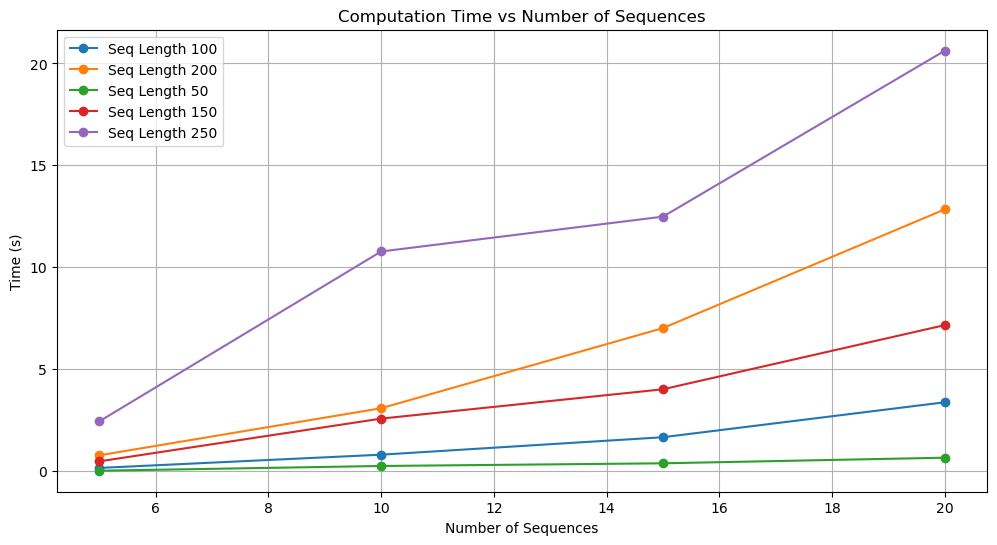

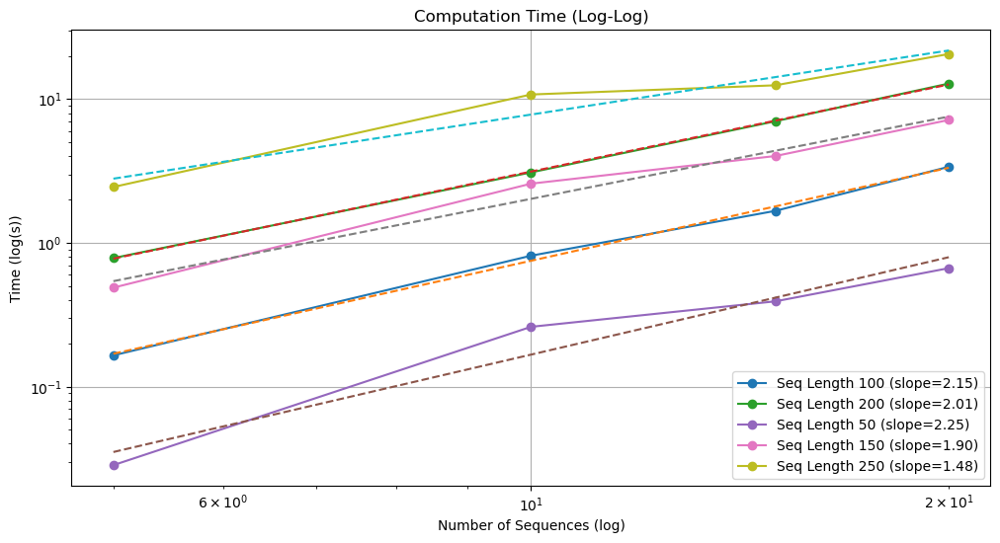

In [24]:
import random
import time
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

# Run experiments and collect results for plotting
def run_experiments_with_plotting():
    sequence_lengths = [50, 100, 150, 200, 250]  # Different sequence lengths
    num_sequences = [x for x in range(5, 25, 5)]  # Different numbers of sequences

    results = {'sequence_lengths': [], 'num_sequences': [], 'times': []}

    for seq_len in sequence_lengths:
        for num_seq in num_sequences:
            # Generate random gene sequences
            genes = [(f"gene_{i}", ''.join(random.choices("ACGT", k=seq_len))) for i in range(num_seq)]

            # Measure the time taken to compute the LCS matrix
            start_time = time.time()
            _ = generate_set_strings_matrix(genes)
            elapsed_time = time.time() - start_time

            # Log the results
            results['sequence_lengths'].append(seq_len)
            results['num_sequences'].append(num_seq)
            results['times'].append(elapsed_time)

    # Generate plots
    plot_results(results)

# Plot the results
def plot_results(results):
    sequence_lengths = np.array(results['sequence_lengths'])
    num_sequences = np.array(results['num_sequences'])
    times = np.array(results['times'])

    # Linear plot of computation time
    plt.figure(figsize=(12, 6))
    for seq_len in set(sequence_lengths):
        mask = sequence_lengths == seq_len
        plt.plot(num_sequences[mask], times[mask], marker='o', label=f"Seq Length {seq_len}")

    plt.title("Computation Time vs Number of Sequences")
    plt.xlabel("Number of Sequences")
    plt.ylabel("Time (s)")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Log-log plot of computation time with regression
    plt.figure(figsize=(12, 6))
    for seq_len in set(sequence_lengths):
        mask = sequence_lengths == seq_len
        log_num_sequences = np.log(num_sequences[mask])
        log_times = np.log(times[mask])
        slope, intercept, _, _, _ = linregress(log_num_sequences, log_times)
        plt.loglog(num_sequences[mask], times[mask], marker='o', label=f"Seq Length {seq_len} (slope={slope:.2f})")
        plt.loglog(num_sequences[mask], np.exp(intercept) * num_sequences[mask] ** slope, linestyle='--')

    plt.title("Computation Time (Log-Log)")
    plt.xlabel("Number of Sequences (log)")
    plt.ylabel("Time (log(s))")
    plt.legend()
    plt.grid(True)
    plt.show()

if __name__ == '__main__':
    run_experiments_with_plotting()


# Question 3


## (a) Local Strategy


Recyling Implementation of the Max Heap from Task Scheduler Assignment

In [25]:
class Node:
    def __init__(self, i, j, lcs_length):
        self.i = i  # Index of the first sequence
        self.j = (
            j  # Index of the second sequence (which will become the parent sequence)
        )
        self.lcs_length = lcs_length  # LCS score between the two sequences
        self.parent = None  # Reference to parent node
        self.children = []  # List of child nodes

    def __repr__(self):
        return f"Node(i={self.i}, j={self.j}, lcs_length={self.lcs_length})"

    def __lt__(self, other):
        # Priority queue uses this to compare nodes (max heap based on LCS score)
        return self.lcs_length > other.lcs_length


In [26]:
class MaxHeapq:
    """
    A class that implements properties and methods
    that support a max priority queue data structure.

    Attributes
    ----------
    heap : list
        A Python list where key values in the max heap are stored.
    heap_size : int
        An integer counter of the number of keys present in the max heap.
    """

    def __init__(self):
        """
        Initializes an empty MaxHeapq instance.

        Parameters
        ----------
        None
        """
        self.heap = []
        self.heap_size = 0

    def is_max_heap(self):
        """
        Checks if the current list satisfies the max heap property.

        Returns
        -------
        bool
            True if the list is a max heap, False otherwise.
        """
        a = self.heap
        n = self.heap_size

        # Check each node to ensure it is greater than its children
        for i in range(n):
            left_child = self.left(i)
            right_child = self.right(i)

            # Check if left child exists and is greater than parent
            if left_child < n and a[i].lcs_length < a[left_child].lcs_length:
                return False

            # Check if right child exists and is greater than parent
            if right_child < n and a[i].lcs_length < a[right_child].lcs_length:
                return False
        return True

    def left(self, i):
        return 2 * i + 1

    def right(self, i):
        return 2 * i + 2

    def parent(self, i):
        return (i - 1) // 2

    def heappush(self, key):
        """
        Inserts a key into the priority queue.

        Parameters
        ----------
        key : Node
            The Node object to be inserted.

        Returns
        -------
        None
        """
        # append a placeholder for new key and then increase its value to correct position
        self.heap.append(Node(i=-1, j=-1, lcs_length=float("-inf"))) 
        self.increase_key(self.heap_size, key)
        self.heap_size += 1

    def increase_key(self, i, key):
        """
        Modifies the value of a key in a max priority queue with a higher value.

        Parameters
        ----------
        i : int
            The index of the key to be modified.
        key : Node
            The new key value (must have a higher lcs_length).

        Raises
        ------
        ValueError
            If new key has a smaller lcs_length than the current key.

        Returns
        -------
        None
        """
        if key.lcs_length < self.heap[i].lcs_length:
            raise ValueError("new key is smaller than the current key")

        self.heap[i] = key
        while i > 0 and self.heap[self.parent(i)].lcs_length < self.heap[i].lcs_length:
            j = self.parent(i)
            self.heap[i], self.heap[j] = self.heap[j], self.heap[i]
            i = j

    def heapify(self, i):
        """
        Creates a max heap from the index given by ensuring that subtree rooted at index i satisfies max heap property.

        Parameters
        ----------
        i : int
            The index of the root node of the subtree to be heapified.

        Returns
        -------
        None
        """
        l = self.left(i)
        r = self.right(i)
        largest = i

        if l < self.heap_size and self.heap[l].lcs_length > self.heap[largest].lcs_length:
            largest = l

        if r < self.heap_size and self.heap[r].lcs_length > self.heap[largest].lcs_length:
            largest = r

        if largest != i:
            self.heap[i], self.heap[largest] = self.heap[largest], self.heap[i]
            self.heapify(largest)

    def heappop(self):
        """
        Returns and removes the largest key in the max priority queue.

        Raises
        ------
        ValueError
            If there are no keys in priority queue (heap underflow).

        Returns
        -------
        Node
            The maximum value (Node object) extracted from the heap.
        """
        if self.heap_size < 1:
            raise ValueError("Heap underflow: There are no keys in priority queue.")

        max_value = self.heap[0]
        self.heap[0] = self.heap[-1]
        self.heap.pop()
        self.heap_size -= 1
        self.heapify(0)
        return max_value


In [27]:
def greedy_max_LCS(selected_root, lcs_matrix):
    """
    Build a tree using a greedy algorithm, maximizing the LCS values
    for connections between sequences.

    Parameters:
        lcs_matrix (list[list[int]]): The LCS similarity matrix.

    Returns:
        Node: The root of the constructed tree.
    """
    n = len(lcs_matrix)
    visited = set()  # Tracks visited nodes to prevent revisiting
    priority_queue = MaxHeapq()  # Max-heap to prioritize nodes by LCS value

    # Initialize the root node based on the global maximum
    root = Node(i=selected_root, j=-1, lcs_length=0)
    visited.add(selected_root)
    priority_queue.heappush(root)

    # Build the tree by iteratively adding nodes
    while priority_queue.heap_size > 0:
        current_node = priority_queue.heappop()

        # Identify the top two unvisited sequences with the highest LCS scores
        top1 = (-1, float("-inf"))  # Highest score (sequence index, score)
        top2 = (-1, float("-inf"))  # Second-highest score

        for sequence_index in range(n):
            if sequence_index not in visited:
                lcs_score = lcs_matrix[current_node.i][sequence_index]
                if lcs_score > top1[1]:
                    top2 = top1
                    top1 = (sequence_index, lcs_score)
                elif lcs_score > top2[1]:
                    top2 = (sequence_index, lcs_score)

        # Add children to the tree for valid top sequences
        for top in [top1, top2]:
            if top[0] != -1:  # Ensure the index is valid
                child_node = Node(i=top[0], j=current_node.i, lcs_length=top[1])
                child_node.parent = current_node
                current_node.children.append(child_node)

                # Mark as visited and push to the priority queue
                visited.add(top[0])
                priority_queue.heappush(child_node)

    return root

def print_tree(node, genes, depth=0):
    """
    Print the tree structure in a hierarchical format.

    Parameters:
        node (Node): The current node being printed.
        genes (list[tuple]): List of gene sequences as (name, sequence).
        depth (int): Current depth in the tree for indentation.
    """
    name = genes[node.i][0]  # Gene name
    print(" " * depth * 2 + f"{name} (LCS: {node.lcs_length})")
    for child in node.children:
        print_tree(child, genes, depth + 1)

def calculate_total_cost(node):
    """
    Calculate the total cost (sum of LCS lengths) for the entire tree.

    Parameters:
        node (Node): The root node of the tree.

    Returns:
        int: Total LCS cost of the tree.
    """
    if node is None:
        return 0

    cost = node.lcs_length
    for child in node.children:
        cost += calculate_total_cost(child)

    return cost

# Construct the tree using the greedy LCS algorithm
selected_root = 6
root = greedy_max_LCS(selected_root, len_lcs_matrix)

# Print the tree structure
print("Tree Structure:")
print_tree(root, genes)

# Calculate and display the total tree cost
total_cost = calculate_total_cost(root)
print(f"\nTotal tree cost: {total_cost}")

Tree Structure:
g (LCS: 0)
  e (LCS: 243)
    b (LCS: 227)
    a (LCS: 214)
  c (LCS: 229)
    d (LCS: 197)
    f (LCS: 195)

Total tree cost: 1305


## (b) Global Strategy


## Iterative Approach

In [28]:
def max_LCS_tree_iterative(weights):
    """
    Computes the maximum LCS tree using a dynamic programming approach.

    Args:
        weights (list of list of int): A matrix where weights[i][j] represents the LCS weight between
                                       sequences i and j.

    Returns:
        tuple: A tuple containing the DP table (dp) and the root table (root) where:
               - dp[i][j] is the maximum total weight for the subtree spanning sequences i to j.
               - root[i][j] is the index of the root for the subtree spanning sequences i to j.
    """
    n = len(weights)
    dp = [[0 for _ in range(n)] for _ in range(n)]
    root = [[-1 for _ in range(n)] for _ in range(n)]

    # Build the DP and Root tables
    for i in range(n):
        dp[i][i] = 0
        root[i][i] = i

    for size in range(2, n + 1):
        for i in range(n - size + 1):
            j = i + size - 1
            max_weight = float('-inf')

            for r in range(i, j + 1):
                left_size = r - i
                right_size = j - r

                if abs(left_size - right_size) > 1:
                    continue

                left_weight = dp[i][r - 1] if r > i else 0
                right_weight = dp[r + 1][j] if r < j else 0

                root_weight = sum(weights[r][k] for k in range(i, j + 1) if k != r)
                total_weight = left_weight + right_weight + root_weight

                if total_weight > max_weight:
                    max_weight = total_weight
                    dp[i][j] = max_weight
                    root[i][j] = r

    print("\nDP Table:")
    for row in dp:
        print(row)

    print("\nRoot Table:")
    for row in root:
        print(row)

    return dp, root

def reconstruct_tree_with_nodes(root, weights, i, j, parent=None):
    """
    Reconstructs the tree structure based on the root table generated by the max_LCS_tree_iterative function.

    Args:
        root (list of list of int): The root table indicating the root for each subtree.
        weights (list of list of int): The LCS weight matrix.
        i (int): Starting index of the subtree.
        j (int): Ending index of the subtree.
        parent (int, optional): Parent node index for the current subtree. Defaults to None.

    Returns:
        Node: The root node of the reconstructed tree.
    """
    if i > j:
        return None

    r = root[i][j]  # Get the root of the current subtree
    # Compute LCS length based on the parent-child relationship
    lcs_length = 0 if parent is None else weights[r][parent]
    node = Node(i=r, j=parent, lcs_length=lcs_length)  # Use `r` as the current node

    # Recurse to build left and right subtrees
    left_child = reconstruct_tree_with_nodes(root, weights, i, r - 1, r)
    right_child = reconstruct_tree_with_nodes(root, weights, r + 1, j, r)

    # Attach children to the current node
    if left_child:
        left_child.parent = node
        node.children.append(left_child)
    if right_child:
        right_child.parent = node
        node.children.append(right_child)

    return node

def print_tree(node, genes, depth=0):
    """
    Prints the tree structure in a hierarchical format.

    Args:
        node (Node): The root node of the tree to print.
        genes (list of tuple): List of gene names and sequences.
        depth (int, optional): The current depth in the tree. Defaults to 0.
    """
    name = genes[node.i][0]  # Get the gene name for the current node
    lcs_info = f"(LCS: {node.lcs_length})" if node.lcs_length > 0 else ""
    print(" " * depth * 2 + f"{name} {lcs_info}")
    for child in node.children:
        print_tree(child, genes, depth + 1)

def calculate_total_cost(node):
    """
    Calculates the total LCS cost for the entire tree.

    Args:
        node (Node): The root node of the tree.

    Returns:
        int: The total LCS cost of the tree.
    """
    if node is None:
        return 0

    cost = node.lcs_length
    for child in node.children:
        cost += calculate_total_cost(child)

    return cost

# Example usage:
dp, root = max_LCS_tree_iterative(len_lcs_matrix)
tree = reconstruct_tree_with_nodes(root, len_lcs_matrix, 0, len(len_lcs_matrix) - 1)

print("\nReconstructed Tree with Nodes:")
print_tree(tree, genes)

total_cost = calculate_total_cost(tree)
print(f"\nTotal cost of the tree: {total_cost}")



DP Table:
[0, 235, 446, 866, 1283, 1771, 2184]
[0, 0, 211, 408, 849, 1284, 1732]
[0, 0, 0, 197, 404, 850, 1294]
[0, 0, 0, 0, 207, 412, 863]
[0, 0, 0, 0, 0, 205, 413]
[0, 0, 0, 0, 0, 0, 208]
[0, 0, 0, 0, 0, 0, 0]

Root Table:
[0, 0, 1, 1, 2, 3, 3]
[-1, 1, 1, 2, 2, 3, 4]
[-1, -1, 2, 2, 3, 3, 4]
[-1, -1, -1, 3, 3, 4, 4]
[-1, -1, -1, -1, 4, 4, 5]
[-1, -1, -1, -1, -1, 5, 5]
[-1, -1, -1, -1, -1, -1, 6]

Reconstructed Tree with Nodes:
d 
  b (LCS: 223)
    a (LCS: 235)
    c (LCS: 211)
  f (LCS: 241)
    e (LCS: 205)
    g (LCS: 208)

Total cost of the tree: 1323


## Recursive Approach

In [29]:
def max_LCS_tree_recursive(lcs_matrix, i, j, memo, root):
    """
    Recursive function to calculate the maximum weight of the subtree
    for the range [i, j] and store intermediate results in memo.

    Args:
        lcs_matrix: An nxn matrix of LCS scores between node pairs.
        i: Start index of the current range.
        j: End index of the current range.
        memo: A dictionary for memoization of the maximum weights.
        root: A 2D array to store the root indices of subtrees.

    Returns:
        The maximum weight of the subtree in range [i, j].
    """
    # Base case: empty range
    if i > j:
        return 0

    # Base case: single node
    if i == j:
        root[i][j] = i
        return 0

    # Check memo
    if (i, j) in memo:
        return memo[(i, j)]

    max_weight = float('-inf')
    best_root = -1

    # Try every node in the range [i, j] as the root
    for r in range(i, j + 1):
        left_size = r - i
        right_size = j - r

        # Enforce balance condition
        if abs(left_size - right_size) > 1:
            continue

        # Recursively compute left and right subtree weights
        left_weight = max_LCS_tree_recursive(lcs_matrix, i, r - 1, memo, root) if r > i else 0
        right_weight = max_LCS_tree_recursive(lcs_matrix, r + 1, j, memo, root) if r < j else 0

        # Calculate root weight
        root_weight = sum(lcs_matrix[r][k] for k in range(i, j + 1) if k != r)

        # Total weight of the subtree
        total_weight = left_weight + right_weight + root_weight

        # Update maximum weight and root index
        if total_weight > max_weight:
            max_weight = total_weight
            best_root = r

    # Store results in memo and root table
    memo[(i, j)] = max_weight
    root[i][j] = best_root
    return max_weight

def reconstruct_tree_with_nodes(root, lcs_matrix, i, j, parent=None):
    """
    Reconstructs the tree using the root indices and LCS matrix,
    while building Node objects.

    Args:
        root: A 2D array containing root indices for subtrees.
        lcs_matrix: The LCS score matrix.
        i: Start index of the current subtree.
        j: End index of the current subtree.
        parent: Parent index for the current node (None for root).

    Returns:
        A Node object representing the tree.
    """
    if i > j:
        return None

    r = root[i][j]  # Get the root of the current subtree
    # Compute LCS length based on the parent-child relationship
    lcs_length = 0 if parent is None else lcs_matrix[r][parent]
    node = Node(i=r, j=parent, lcs_length=lcs_length)  # Use `r` as the current node

    # Recurse to build left and right subtrees
    left_child = reconstruct_tree_with_nodes(root, lcs_matrix, i, r - 1, r)
    right_child = reconstruct_tree_with_nodes(root, lcs_matrix, r + 1, j, r)

    # Attach children to the current node
    if left_child:
        left_child.parent = node
        node.children.append(left_child)
    if right_child:
        right_child.parent = node
        node.children.append(right_child)

    return node

def print_tree(node, genes, depth=0):
    """Print the tree structure."""
    name = genes[node.i][0]  # Get the gene name for the current node
    lcs_info = f"(LCS: {node.lcs_length})" if node.lcs_length > 0 else ""
    print(" " * depth * 2 + f"{name} {lcs_info}")
    for child in node.children:
        print_tree(child, genes, depth + 1)

def calculate_total_cost(node):
    """Calculate the total cost of the tree."""
    if node is None:
        return 0

    cost = node.lcs_length
    for child in node.children:
        cost += calculate_total_cost(child)

    return cost

# Initialize the memo and root tables
memo = {}
root = [[-1 for _ in range(len(len_lcs_matrix))] for _ in range(len(len_lcs_matrix))]

# Call the recursive function
max_LCS_tree_recursive(len_lcs_matrix, 0, len(len_lcs_matrix) - 1, memo, root)

# Reconstruct the tree using nodes
tree = reconstruct_tree_with_nodes(root, len_lcs_matrix, 0, len(len_lcs_matrix) - 1)

# Print the reconstructed tree
print("\nReconstructed Tree with Nodes:")
print_tree(tree, genes)

# Calculate total cost
total_cost = calculate_total_cost(tree)
print(f"\nTotal cost of the tree: {total_cost}")



Reconstructed Tree with Nodes:
d 
  b (LCS: 223)
    a (LCS: 235)
    c (LCS: 211)
  f (LCS: 241)
    e (LCS: 205)
    g (LCS: 208)

Total cost of the tree: 1323


# Experiments

Experiments for each approach will be run considering a matrix of LCS as input.

* Input type 1: similar numbers of LCS as the genes example (195 < sample < 250)
* Input type 2: low relationships (all samples lower than 195 but with a lower bound of 0)
* Input type 3: high relationships (all samples higher than 250 but with an upper bound of the same range as above, 445)

In [30]:
def generate_matrix(n, lower_bound, upper_bound):
    """
    Generate a random nxn matrix with values between lower_bound and upper_bound.

    Args:
        n: The size of the matrix.
        lower_bound: Minimum value for matrix entries.
        upper_bound: Maximum value for matrix entries.

    Returns:
        A randomly generated nxn matrix.
    """
    return [[random.randint(lower_bound, upper_bound) for j in range(n)] for i in range(n)]

## Greedy Approach

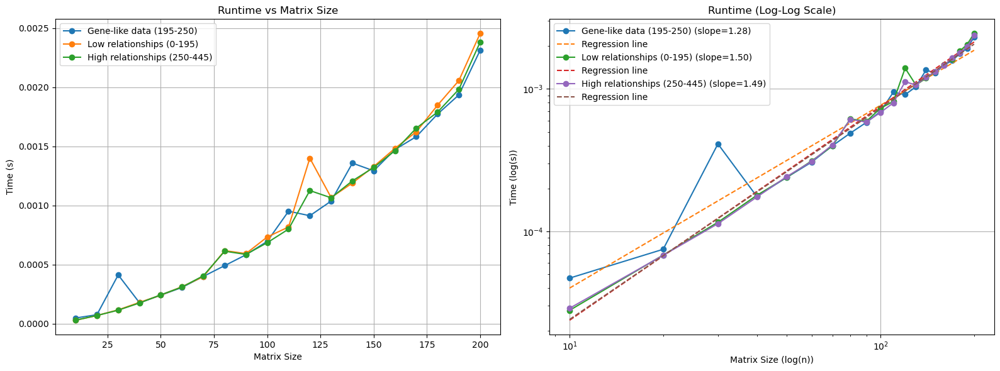

In [31]:
import time
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

def run_greedy_max_lcs_experiments_with_inputs():
    """
    Measure runtime of greedy_max_LCS for varying input sizes and types, then plot results.

    Parameters:
        selected_root (int): Index of the initial root node.
    """
    input_types = [
        ("Gene-like data (195-250)", 195, 250),
        ("Low relationships (0-195)", 0, 195),
        ("High relationships (250-445)", 250, 445),
    ]
    sizes = range(10, 201, 10)  # Matrix sizes to test
    results = {name: {'sizes': [], 'times': []} for name, _, _ in input_types}

    for input_name, lower, upper in input_types:
        for size in sizes:
            # Generate random LCS matrix
            matrix = generate_matrix(size, lower, upper)
            
            selected_root = random.randint(0, size - 1)

            # runtime
            start_time = time.time()
            greedy_max_LCS(selected_root, matrix)
            elapsed_time = time.time() - start_time

            # results
            results[input_name]['sizes'].append(size)
            results[input_name]['times'].append(elapsed_time)

    plot_runtime_vs_input_types(results)

def plot_runtime_vs_input_types(results):
    """
    Plot runtime for different input types.

    Parameters:
        results (dict): Dictionary containing sizes and times for each input type.
    """
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    for input_name, data in results.items():
        sizes = np.array(data['sizes'])
        times = np.array(data['times'])

        # Linear plot
        axes[0].plot(sizes, times, marker='o', label=input_name)

        # Log-log plot with regression
        log_sizes = np.log(sizes)
        log_times = np.log(times)
        slope, intercept, _, _, _ = linregress(log_sizes, log_times)
        axes[1].loglog(sizes, times, marker='o', label=f"{input_name} (slope={slope:.2f})")
        axes[1].loglog(sizes, np.exp(intercept) * sizes ** slope, linestyle='--', label="Regression line")

    # Linear plot 
    axes[0].set_title("Runtime vs Matrix Size")
    axes[0].set_xlabel("Matrix Size")
    axes[0].set_ylabel("Time (s)")
    axes[0].legend()
    axes[0].grid(True)

    # Log-log plot 
    axes[1].set_title("Runtime (Log-Log Scale)")
    axes[1].set_xlabel("Matrix Size (log(n))")
    axes[1].set_ylabel("Time (log(s))")
    axes[1].legend()
    axes[1].grid(True)

    plt.tight_layout()
    plt.show()

run_greedy_max_lcs_experiments_with_inputs()


## Iterative Global Approach 


DP Table:
[0, 231, 455, 914, 1349, 1825, 2270, 2981, 3698, 4367, 4878, 5732, 6393, 7122, 7801, 8700, 9404, 10432, 11337, 12202, 13167, 14110, 14719, 15791, 16831]
[0, 0, 234, 438, 903, 1357, 1815, 2277, 2994, 3538, 4328, 5032, 5697, 6419, 7098, 7573, 8534, 9499, 10404, 11135, 12167, 13082, 14082, 14888, 15928]
[0, 0, 0, 236, 450, 904, 1369, 1831, 2218, 2898, 3671, 4375, 5004, 5726, 6294, 6920, 7550, 8544, 9458, 10403, 11315, 12297, 13209, 14055, 14961]
[0, 0, 0, 0, 214, 435, 929, 1361, 1806, 2213, 3035, 3738, 4368, 4912, 5606, 6282, 6928, 7614, 8528, 9520, 10596, 11457, 12369, 13184, 14090]
[0, 0, 0, 0, 0, 249, 485, 946, 1381, 1886, 2357, 3060, 3617, 4320, 4965, 5641, 6366, 7065, 7650, 8757, 9680, 10541, 11208, 12233, 13058]
[0, 0, 0, 0, 0, 0, 248, 475, 947, 1406, 1877, 2233, 3007, 3687, 4332, 4906, 5724, 6389, 7010, 7685, 8608, 9484, 10377, 11315, 12216]
[0, 0, 0, 0, 0, 0, 0, 227, 453, 912, 1362, 1854, 2276, 2956, 3582, 4261, 4966, 5650, 6401, 7076, 7612, 8534, 9427, 10382, 11051]
[0


DP Table:
[0, 238, 473, 936, 1298, 1869, 2282, 3030, 3679, 4384, 4969, 5763, 6446, 7107, 7793, 8775, 9614, 10524, 11437, 12344, 13142, 14089, 14937, 15877, 16747, 17669, 18638, 19492, 20395, 21292, 22143, 23455, 24546, 25621, 26508, 27829, 28921, 30014, 31142, 32528, 33624, 34587, 35570, 36699, 37640, 38834, 39955, 41077, 42186, 43320, 44520, 45652, 46658, 48046, 49055, 50201, 51129, 52288, 53336, 54763, 55854, 56632, 57643, 59369, 60848, 62292, 63369, 64862, 66248, 67483, 68475, 70376, 71657, 72676, 73756, 75391, 76847, 78258, 79277, 80807, 82450, 83999, 85157, 86664, 87539, 89044, 90394, 91800, 92749, 94238, 95603, 96936, 98040, 99246, 100466, 102030, 103744, 105120, 106471, 107820, 109039, 110553, 111675, 113025, 114401, 115802, 117075, 118320, 119767, 121272, 122678, 123974, 125211, 126453, 127785, 129148, 130160, 131506, 132808, 134393, 135969, 137576, 138907, 140092, 140351, 142320, 143624, 145391, 146494, 148834, 150398, 151967, 153227, 155467, 157089, 158503, 159827, 161148, 1


DP Table:
[0, 248, 474, 940, 1366, 1850, 2263, 2958, 3624, 4286, 4887, 5689, 6342, 6928, 7580, 8471, 9337, 10318, 11215, 12134, 12897, 13900, 14731, 15731, 16660, 17614, 18206, 19339, 20124, 21044, 21881, 23008, 24096, 25308, 26482, 27508, 28733, 29780, 30784, 32247, 33002, 34253, 35338, 36441, 37456, 38621, 39547, 40789, 41984, 43215, 44234, 45666, 46686, 47826, 48304, 49975, 51158, 52238, 53190, 54353, 55508, 56613, 57535, 58913, 60182, 61540, 62731, 64364, 65727, 67178, 68511, 69850, 70796, 72520, 73882, 75276, 76536, 77743, 79039, 80937, 82362, 83762, 84238, 86068, 87253, 88807, 90100, 91496, 92319, 93707, 95024, 96764, 98015, 99202, 100371, 101912, 102978, 104545, 106066, 107540, 109009, 110438, 111175, 112840, 114164, 115725, 117122, 118398, 119496, 120752, 121466, 122945, 124724, 126165, 127553, 129269, 130633, 131650, 132779, 134025, 135372, 136922, 138012, 139460, 140814, 142285, 142908, 144597, 146218, 148273, 149817, 151385, 152722, 154124, 155473, 157340, 159195, 160996, 1


DP Table:
[0, 220, 440, 890, 1310, 1792, 2160, 2919, 3576, 4271, 4868, 5599, 6316, 6934, 7435, 8380, 9392, 10317, 11095, 12104, 13066, 13971, 14861, 15744, 16665, 17626, 18562, 19428, 20041, 20899, 21528, 22919, 24000, 25206, 26363, 27681, 28693, 29742, 30874, 31957, 33267, 34409, 35386, 36534, 37603, 38798, 39676, 41058, 42111, 43419, 44675, 45847, 46814, 48047, 49149, 50342, 51293, 52400, 53096, 54201, 55561, 56426, 57400, 58798, 60290, 61565, 62732, 64184, 65607, 67098, 68411, 69867, 71245, 72505, 73960, 75518, 76658, 78076, 79282, 80661, 81565, 83116, 84829, 86473, 87718, 88816, 89517, 91046, 92510, 93674, 94867, 96771, 98072, 99283, 100186, 101822, 103358, 104971, 106172, 107709, 108993, 110151, 111156, 112833, 114413, 115803, 117135, 118430, 119852, 120962, 122271, 123879, 125301, 126615, 126997, 129020, 130351, 131530, 132593, 134004, 135479, 137094, 138027, 139313, 140483, 142180, 142889, 145023, 146030, 148152, 149742, 151369, 152881, 154680, 155537, 157040, 158394, 160869, 1


DP Table:
[0, 248, 458, 912, 1355, 1795, 2231, 2938, 3590, 4289, 4887, 5534, 6299, 6942, 7541, 8436, 9349, 10258, 11086, 12102, 12996, 13852, 14647, 15630, 16381, 17355, 18219, 19211, 20070, 20984, 21646, 22880, 23806, 25130, 26242, 27443, 28392, 29389, 30476, 31805, 33074, 34246, 35263, 36517, 37654, 38705, 39213, 40617, 41902, 43121, 44252, 45433, 46110, 47335, 48207, 49601, 50752, 51960, 52883, 54008, 55193, 56307, 57421, 58728, 60006, 61355, 62538, 64428, 65801, 67092, 68098, 69819, 71264, 72387, 73315, 74756, 76221, 77368, 78333, 80296, 81666, 83155, 84672, 85944, 87099, 88679, 90077, 91194, 92819, 94126, 94666, 96765, 98064, 99279, 99903, 101586, 103273, 104807, 105588, 107255, 108458, 109830, 111046, 112918, 114392, 115496, 116473, 118045, 119362, 120160, 121190, 123328, 124818, 126137, 127376, 128566, 130012, 131319, 132031, 133498, 134774, 136357, 137547, 138872, 140182, 142183, 142881, 144772, 146094, 147814, 149304, 150758, 152501, 154290, 155756, 157531, 159063, 160877, 16


DP Table:
[0, 224, 454, 922, 1342, 1831, 2292, 3008, 3628, 4290, 4932, 5656, 6368, 7029, 7599, 8531, 9439, 10436, 11340, 12212, 12984, 14074, 14865, 15879, 16741, 17569, 18346, 19391, 20281, 21110, 21702, 23034, 24311, 25509, 26354, 27690, 28876, 29953, 31031, 32191, 33270, 34302, 35372, 36848, 37866, 38930, 39846, 40958, 42269, 43744, 44781, 46030, 46912, 48087, 49251, 50332, 51608, 52713, 53307, 54336, 55551, 56507, 57265, 59061, 60582, 62244, 63713, 64976, 66113, 67429, 68354, 70133, 71385, 72976, 74236, 75603, 76772, 78068, 79169, 80749, 82015, 83499, 84979, 86154, 87483, 88537, 89934, 91455, 92958, 94157, 95225, 97259, 98618, 99693, 100193, 102151, 103539, 104686, 106026, 107965, 109333, 110407, 111718, 113575, 114813, 115701, 117027, 118817, 119963, 121085, 122212, 123752, 125193, 126624, 127641, 129446, 130634, 131935, 132850, 134170, 135178, 136772, 138125, 139730, 140830, 141883, 142660, 144872, 146447, 148312, 149674, 151856, 153453, 155277, 156874, 158474, 159536, 161200, 1


DP Table:
[0, 217, 462, 926, 1367, 1832, 2276, 2960, 3618, 4335, 5008, 5681, 6382, 6991, 7623, 8531, 9486, 10385, 11114, 12281, 13212, 14054, 14729, 15823, 16759, 17764, 18699, 19605, 20160, 21122, 21969, 23313, 24517, 25589, 26537, 27775, 28841, 29939, 30793, 32140, 33198, 34638, 35729, 36891, 37685, 38905, 39740, 40969, 42230, 43258, 44233, 45600, 46861, 48161, 49149, 50339, 51398, 52313, 53278, 54423, 55548, 56787, 57925, 59411, 60480, 62028, 63408, 64937, 66206, 67461, 68421, 69887, 71321, 72763, 74153, 75403, 76738, 77982, 78817, 80372, 81839, 83222, 84714, 86394, 87813, 89131, 90351, 91750, 92905, 94195, 95469, 96986, 98584, 99937, 100198, 102260, 103692, 105062, 106213, 107603, 108797, 110263, 111340, 113056, 114520, 116061, 117558, 118871, 120122, 121675, 122412, 123963, 125509, 126854, 127831, 129412, 130400, 132027, 133248, 134629, 135828, 137132, 138367, 139702, 140754, 142272, 143367, 145832, 147312, 148546, 149599, 151866, 153599, 155415, 156530, 158068, 160059, 161768, 1


DP Table:
[0, 222, 433, 887, 1321, 1757, 2158, 2884, 3572, 4284, 4881, 5552, 6170, 6891, 7590, 8494, 9322, 10271, 11180, 12153, 13040, 13921, 14663, 15596, 16364, 17228, 18036, 19034, 19909, 21044, 21855, 23047, 24137, 25068, 26156, 27495, 28726, 29789, 30828, 31955, 33031, 34213, 35182, 36468, 37521, 38687, 39833, 41019, 41990, 42991, 44136, 45472, 46527, 47484, 48336, 49623, 50787, 51941, 52954, 54143, 55172, 56701, 57747, 59130, 60216, 61572, 63123, 64502, 65452, 67060, 68226, 69955, 71217, 72615, 74040, 75363, 76450, 78002, 79029, 80508, 82148, 83424, 84373, 86068, 87455, 88572, 89384, 91218, 92910, 94228, 95480, 96799, 97827, 99454, 100635, 102231, 103272, 104663, 105640, 107557, 108736, 110106, 110966, 112770, 114145, 115862, 117435, 118834, 119481, 120639, 121321, 123347, 124668, 126002, 126951, 128845, 130036, 131216, 131986, 133881, 135086, 136589, 137659, 139860, 140990, 142468, 143580, 145409, 146137, 147719, 148980, 150887, 152492, 154944, 156424, 158232, 159475, 161092, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 249, 450, 905, 1361, 1747, 2230, 2913, 3573, 4309, 4969, 5666, 6198, 6909, 7512, 8500, 9313, 10273, 11116, 12025, 12886, 13831, 14691, 15664, 16572, 17484, 18324, 19199, 19983, 20893, 21792, 22894, 24225, 25438, 26457, 27609, 28571, 29768, 30784, 31974, 32955, 33942, 35101, 36436, 37415, 38902, 39924, 41025, 41887, 43195, 44363, 45397, 46486, 47570, 48287, 49562, 50724, 51834, 52858, 53846, 54871, 56154, 57150, 58579, 59796, 61674, 63061, 64497, 65467, 67435, 68799, 70295, 71252, 72463, 73387, 75268, 76645, 77736, 78633, 80392, 81718, 83321, 84665, 85886, 86709, 88092, 89123, 91271, 92624, 93914, 95236, 96822, 98003, 99235, 100248, 102058, 103153, 104508, 105947, 107146, 108724, 110168, 111163, 112596, 113829, 115723, 117015, 118045, 118905, 120065, 121046, 122794, 124061, 125736, 127398, 128834, 129891, 131148, 132145, 133517, 134732, 136078, 137192, 139693, 140833, 142049, 142227, 144833, 146119, 147224, 148660, 150899, 152723, 154716, 156232, 157895, 159514, 161148, 1


DP Table:
[0, 247, 471, 946, 1373, 1803, 2207, 2883, 3592, 4289, 4863, 5567, 6198, 6925, 7616, 8512, 9361, 10434, 11351, 12250, 13048, 13944, 14590, 15518, 16471, 17380, 18204, 19157, 20051, 20942, 21802, 22939, 24138, 25310, 26204, 27370, 28665, 30090, 31197, 32382, 33181, 34260, 35364, 36700, 37801, 38905, 39876, 41091, 42159, 43384, 44399, 45578, 46490, 47574, 48465, 49827, 51102, 52203, 53224, 54374, 55455, 56474, 57171, 58876, 60251, 62022, 63342, 64663, 66094, 67546, 68622, 70062, 71089, 72491, 73944, 75718, 77155, 78459, 79604, 81069, 82326, 83801, 84918, 86144, 87491, 88785, 89766, 91348, 92839, 94319, 95799, 96975, 98112, 99498, 100670, 102144, 103292, 104742, 106014, 107697, 109165, 110053, 111532, 113022, 114352, 115508, 116738, 118104, 119134, 120559, 121856, 123408, 124606, 126047, 127199, 129049, 130609, 131925, 132378, 134086, 135264, 136655, 137845, 139196, 140555, 141547, 142254, 144250, 146090, 147736, 149036, 151192, 152949, 154818, 156023, 158015, 159341, 161231, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 248, 421, 939, 1353, 1750, 2094, 2915, 3648, 4304, 4868, 5635, 6339, 6964, 7377, 8505, 9432, 10405, 11224, 12157, 13127, 14013, 14620, 15753, 16691, 17676, 18578, 19504, 20093, 20943, 21611, 23009, 24246, 25370, 26514, 27625, 28697, 29813, 30900, 32439, 33591, 34689, 35500, 36707, 37802, 38769, 39796, 41102, 42304, 43232, 44362, 45840, 47130, 48202, 49061, 50279, 51588, 52722, 53412, 54574, 55702, 56765, 57259, 59019, 60393, 62035, 63474, 64857, 66050, 67401, 68515, 70139, 71524, 72795, 73941, 75151, 76791, 78069, 79185, 80896, 82328, 83675, 85077, 86673, 87972, 89421, 90737, 92027, 92774, 94411, 95591, 96841, 97757, 99287, 100548, 102536, 103856, 104800, 106210, 107651, 108742, 109915, 111386, 113576, 114854, 116258, 117289, 118746, 120146, 121525, 122303, 123941, 125325, 126690, 127993, 129443, 130618, 131928, 132907, 134477, 135541, 136861, 138171, 139810, 140943, 142093, 142658, 144285, 146053, 148202, 150044, 151596, 152974, 154703, 156479, 158086, 159391, 161107, 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 182, 280, 497, 833, 956, 953, 1401, 1644, 2283, 2608, 2870, 2974, 3440, 3545, 4145, 4690, 5281, 5403, 6047, 6577, 7109, 7522, 7909, 8207, 8348, 8176, 8822, 9229, 9877, 10045, 11308, 11761, 12062, 12508, 13694, 14335, 13869, 14477, 15229, 15369, 16129, 16748, 17222, 17683, 17664, 17963, 19509, 20382, 20070, 19608, 20852, 21147, 21240, 21538, 22262, 22533, 23599, 23972, 24428, 24996, 25591, 26036, 27151, 28560, 28997, 29663, 30280, 30098, 31282, 31315, 32705, 34501, 34960, 34565, 35425, 35435, 36167, 37129, 37472, 38213, 39832, 40374, 40774, 40171, 41042, 41811, 42580, 42316, 42633, 43082, 45081, 44805, 45061, 45356, 48547, 49774, 50335, 50128, 50442, 48947, 50384, 50709, 51697, 52533, 53247, 52978, 53629, 53376, 54462, 54832, 56165, 57188, 57462, 56994, 57781, 58118, 61039, 61682, 62706, 62037, 62200, 63055, 63750, 64274, 65538, 62196, 66163, 66991, 67995, 67851, 70737, 71066, 71691, 72463, 72982, 74841, 75598, 73681, 76263, 76741, 77410, 78110, 79222, 80506, 81689, 82264


DP Table:
[0, 176, 150, 727, 972, 1162, 698, 1686, 2059, 2423, 2672, 3049, 3353, 3680, 2646, 4383, 4861, 5325, 5481, 6081, 6427, 7201, 7549, 8023, 7763, 8756, 9143, 9567, 9934, 10298, 8450, 11129, 11642, 12234, 12942, 13639, 13915, 14335, 14179, 15805, 16476, 16704, 16887, 17499, 18114, 18812, 18622, 19908, 21037, 20687, 21403, 22717, 22154, 23443, 23676, 23974, 25116, 25456, 25712, 26069, 26075, 25252, 23471, 27670, 28345, 28982, 29719, 30064, 30656, 31123, 31315, 34229, 34847, 35582, 34177, 34914, 35712, 36614, 35416, 37924, 39267, 40579, 41123, 41654, 41746, 41696, 41430, 42906, 43260, 43660, 44628, 45437, 46102, 46500, 45061, 46889, 48251, 49130, 49653, 50905, 51399, 50957, 51764, 52325, 54043, 54576, 54329, 56322, 55681, 55860, 55583, 57191, 57725, 58605, 58276, 60244, 60707, 61011, 59781, 61426, 61763, 62200, 62384, 61510, 62242, 62656, 61098, 65536, 66618, 67617, 69940, 71621, 69385, 71913, 72759, 73303, 73311, 74020, 73875, 75545, 76109, 76354, 75965, 80663, 81501, 82551, 8327


DP Table:
[0, 118, 127, 454, 734, 974, 1005, 1516, 1738, 2066, 2376, 2759, 3140, 3460, 3376, 4181, 4692, 4865, 5382, 5943, 6146, 7013, 7270, 7770, 8135, 8239, 8140, 8784, 9628, 9562, 9963, 10434, 11513, 12145, 11923, 12524, 12965, 13313, 13747, 14546, 14945, 16146, 17007, 17694, 17902, 18547, 18987, 19989, 19956, 20798, 21383, 21762, 21647, 22175, 21993, 23252, 22716, 24443, 24511, 25200, 25815, 26421, 25598, 27029, 29134, 29894, 29991, 30426, 31258, 32181, 32293, 33040, 32410, 33366, 34043, 34913, 35110, 36771, 37044, 37612, 37374, 38112, 38718, 39157, 39407, 41736, 41806, 43499, 44438, 44837, 45681, 46704, 46968, 46865, 45737, 48272, 48066, 49010, 49619, 51318, 50676, 51147, 51717, 53373, 52112, 53326, 53079, 54606, 55567, 54768, 55271, 56243, 57050, 57072, 58502, 60010, 60595, 59632, 59347, 61496, 62034, 62513, 62236, 62145, 63632, 64324, 61938, 64802, 65646, 68057, 69267, 70931, 72171, 73191, 71419, 72866, 73543, 75182, 76169, 77796, 77833, 78795, 76690, 78772, 79579, 80895, 81386


DP Table:
[0, 22, 11, 442, 610, 830, 771, 1301, 1628, 1925, 2317, 2572, 2661, 2879, 3350, 4320, 4850, 5349, 5431, 5851, 5296, 6545, 6973, 7527, 7902, 8368, 8287, 8659, 8506, 9497, 9654, 11041, 11458, 11747, 12510, 13194, 13522, 13921, 14296, 14637, 15209, 15843, 14893, 16560, 16702, 17389, 17787, 18595, 18786, 20538, 21320, 21906, 21259, 21338, 20722, 23290, 23743, 23936, 23082, 25235, 25583, 25111, 25287, 26855, 28028, 28822, 27926, 29294, 30548, 31829, 32191, 33613, 33163, 33567, 33900, 35181, 37005, 37551, 35994, 37793, 38543, 38481, 38087, 40715, 41377, 41619, 40491, 42091, 42991, 43234, 41655, 42749, 42972, 43800, 44104, 46824, 47684, 48591, 47138, 49595, 51063, 51771, 49920, 52785, 53316, 54934, 53906, 55026, 54051, 53650, 53385, 56433, 57063, 58946, 60148, 60133, 59714, 59591, 58726, 61608, 62844, 63552, 62666, 63241, 61932, 64545, 62958, 65632, 65835, 68266, 68430, 69035, 71078, 72223, 69165, 70884, 73106, 75094, 75394, 75892, 76469, 76477, 75290, 78397, 79097, 80145, 81243, 8


DP Table:
[0, 148, 161, 333, 631, 760, 801, 1193, 1334, 2074, 2443, 2738, 3108, 3344, 3421, 3946, 4072, 4291, 4553, 5627, 5737, 6215, 6430, 7504, 8118, 8311, 8366, 9179, 9171, 9874, 10134, 11081, 10919, 11110, 11498, 13213, 13482, 14096, 13732, 15559, 16271, 16662, 16278, 17225, 17013, 18027, 18554, 19894, 20998, 21381, 20207, 21473, 21898, 22422, 22481, 22941, 23241, 23485, 23631, 25244, 26158, 26469, 24515, 25878, 26704, 27709, 27950, 28672, 28353, 29763, 30390, 31487, 32098, 34165, 34643, 35284, 35282, 34495, 35301, 36652, 37421, 39277, 39606, 40114, 39150, 39884, 40433, 41440, 42948, 43370, 42375, 44719, 45863, 46457, 43812, 46181, 48108, 49882, 50409, 51520, 51726, 52061, 50320, 52386, 53222, 54210, 54611, 55056, 53716, 56064, 55405, 57604, 57304, 57881, 59183, 59915, 57476, 60707, 61098, 61855, 61024, 62707, 63471, 63505, 63617, 62522, 62600, 63634, 65256, 66611, 66552, 68867, 69890, 69994, 70866, 71385, 71762, 72352, 72126, 74120, 74122, 74738, 73500, 77241, 79185, 79671, 76564

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 56, 179, 409, 605, 754, 953, 1303, 1624, 1914, 2051, 2547, 3121, 3513, 3166, 3987, 4352, 5028, 5484, 5956, 6617, 7080, 6690, 7076, 7444, 8797, 9151, 9684, 10074, 9612, 8518, 9986, 10970, 11661, 12060, 13453, 14077, 13896, 13923, 15010, 15592, 16305, 17054, 17541, 17828, 18061, 18303, 18703, 18314, 20017, 20834, 21819, 22488, 23450, 23891, 24361, 23798, 25176, 25768, 25723, 25273, 25708, 24116, 27175, 27878, 28870, 28148, 30969, 31606, 32470, 33048, 33234, 33953, 35272, 35316, 36185, 35823, 36288, 36622, 37188, 37474, 39178, 39988, 40464, 40717, 41444, 42265, 43112, 43894, 44137, 46007, 46608, 46085, 46491, 44869, 46861, 47974, 49466, 49707, 49964, 51306, 53156, 52604, 53158, 54474, 56118, 56727, 56051, 56158, 58045, 57661, 59854, 59741, 59347, 59003, 59464, 58617, 61386, 62178, 63435, 62194, 62049, 62442, 63400, 63903, 63210, 61719, 66663, 68603, 69618, 68493, 69102, 70178, 70971, 68229, 73309, 73724, 77153, 78021, 78664, 78203, 79682, 80490, 80940, 80281, 82115, 80790, 


DP Table:
[0, 182, 85, 630, 846, 932, 971, 1460, 1696, 2218, 2425, 2682, 3272, 3706, 2901, 3875, 4649, 5087, 5327, 6075, 6483, 6870, 5910, 7337, 7685, 9211, 9560, 9631, 9876, 10486, 9335, 10204, 10976, 12282, 12962, 13525, 12829, 13867, 14326, 15749, 16426, 16734, 16422, 17418, 18399, 18494, 16887, 19356, 19876, 20260, 20741, 22332, 22744, 22613, 21846, 23523, 24324, 24564, 24161, 25735, 26275, 25696, 25318, 25897, 26880, 28021, 28263, 29853, 31142, 31924, 31299, 33158, 33804, 33371, 34330, 35458, 35820, 36485, 37185, 37955, 38415, 38551, 39733, 40544, 41120, 41995, 43004, 43533, 42920, 43762, 44150, 44566, 44526, 45081, 44947, 46333, 47925, 49341, 50527, 51088, 50952, 50824, 51624, 54140, 54839, 54457, 54454, 55285, 55832, 56558, 54273, 59277, 60067, 60546, 61275, 61309, 60296, 60319, 60323, 61738, 64202, 65660, 65585, 65749, 64392, 64753, 62090, 64569, 65146, 67649, 68483, 69018, 69190, 71094, 72055, 73768, 74408, 74719, 73598, 77225, 78211, 79174, 76461, 77829, 79017, 81666, 82199,


DP Table:
[0, 64, 80, 416, 634, 913, 1118, 1398, 1851, 2037, 2292, 2612, 2921, 3322, 3384, 4171, 4543, 5247, 5793, 6192, 6149, 6771, 7116, 7666, 8058, 8322, 8618, 9026, 10190, 10164, 9828, 10619, 11031, 11909, 12444, 13609, 14256, 14892, 15210, 15928, 15388, 16311, 16160, 16897, 17681, 17987, 17852, 19149, 19584, 20449, 20255, 21180, 22062, 22352, 22228, 23317, 23604, 23720, 24341, 25348, 25833, 26023, 25329, 26313, 27568, 28394, 29186, 29787, 30517, 31694, 32117, 32857, 33290, 34731, 35236, 36214, 36083, 36714, 36875, 37898, 38589, 39521, 38378, 40966, 41662, 41233, 40573, 43429, 44101, 45266, 44168, 44947, 45669, 46184, 45809, 46344, 48524, 48984, 48664, 49701, 49892, 50286, 50930, 53061, 53351, 53682, 52654, 54447, 54910, 55167, 54739, 56186, 56453, 57899, 58429, 59063, 59741, 60292, 59653, 61124, 61434, 63299, 63443, 63732, 63496, 64120, 62310, 64002, 64884, 67401, 68308, 70367, 71083, 72176, 71057, 72750, 72511, 75071, 75435, 76962, 77475, 78181, 76817, 78744, 78587, 81379, 81905

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 64, 134, 397, 638, 734, 715, 1394, 1859, 1809, 1866, 2878, 3021, 3242, 2551, 4167, 4516, 5044, 5392, 5852, 6146, 6323, 5752, 6890, 7236, 8412, 8797, 8665, 9179, 9146, 9024, 10367, 11199, 11711, 11464, 13483, 13610, 14022, 13692, 14881, 15727, 16464, 15779, 16358, 17080, 17353, 16149, 18874, 19729, 20284, 19614, 21911, 22469, 22656, 23265, 24304, 23056, 24267, 24603, 25515, 25898, 25328, 25136, 26569, 27452, 28812, 29346, 29608, 30273, 31137, 31055, 33550, 34344, 34499, 34333, 35161, 35870, 36489, 35843, 36602, 38244, 38881, 38279, 40884, 41442, 41890, 40971, 42016, 42646, 44610, 45146, 45326, 43738, 44545, 45135, 46298, 47045, 48497, 49099, 49103, 50122, 50996, 50867, 52029, 53502, 55149, 54477, 54703, 54720, 56361, 57084, 57620, 58686, 59712, 57418, 58219, 59044, 60178, 60497, 60965, 62722, 63379, 61839, 63173, 61499, 63707, 63605, 65964, 64402, 66726, 67261, 69667, 70558, 70495, 70000, 70815, 72392, 73474, 73880, 74565, 74266, 75811, 75261, 78949, 80885, 80587, 79468, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 432, 607, 1442, 2220, 2778, 3410, 4497, 5461, 6679, 7726, 9129, 10185, 10791, 11700, 13050, 14896, 16379, 17337, 18872, 20431, 21471, 22919, 24839, 26397, 28068, 29554, 30996, 31352, 33448, 34805, 36536, 37643, 39538, 41323, 43625, 45570, 47458, 48316, 50102, 51709, 54291, 56225, 58212, 58873, 60655, 62161, 64622, 66427, 68095, 69750, 71866, 73595, 75598, 76688, 79398, 81180, 82504, 83889, 86527, 88277, 88894, 90754, 93093, 95648, 97842, 98118, 101755, 104036, 105770, 107586, 110027, 113407, 115290, 116520, 119822, 121699, 123101, 124130, 127323, 129394, 131259, 131501, 135113, 138023, 140404, 141826, 145671, 147288, 149351, 149801, 152242, 155094, 157410, 158183, 160571, 163525, 166036, 167519, 170347, 172490, 174556, 176346, 178467, 180294, 183140, 185101, 187341, 188779, 190176, 191938, 194933, 196426, 199631, 202160, 203983, 205829, 207714, 209055, 211821, 214630, 216333, 218152, 220042, 220518, 223628, 224391, 227338, 231284, 234843, 235716, 239221, 241671, 243512, 


DP Table:
[0, 433, 688, 1684, 2493, 3087, 3430, 4853, 6101, 7288, 8051, 9238, 10422, 11537, 12309, 14085, 14816, 16362, 17686, 19488, 21055, 22448, 23244, 24878, 26155, 28362, 29764, 31432, 32770, 34319, 33759, 36817, 38852, 40348, 40831, 43666, 45700, 47296, 48101, 50505, 52403, 55076, 56904, 58321, 58960, 60625, 62386, 64214, 65797, 68436, 70005, 71756, 73736, 75666, 77217, 80900, 82598, 83663, 85291, 86418, 88846, 90057, 89141, 92980, 95812, 97625, 99916, 102342, 102839, 106135, 107991, 110592, 111087, 115385, 117642, 119420, 119933, 122321, 124057, 126638, 128198, 131681, 133918, 137638, 139837, 141136, 141261, 145279, 147820, 149955, 150241, 152446, 153811, 155030, 157126, 160652, 162464, 165440, 166518, 168675, 170190, 173561, 175771, 177407, 179326, 182916, 185087, 187045, 188590, 190420, 190963, 195000, 197286, 200061, 202310, 204536, 207336, 210001, 209262, 212446, 214001, 216360, 218824, 220725, 222418, 224293, 222974, 227305, 230103, 232999, 235752, 240117, 242576, 244132, 


DP Table:
[0, 385, 728, 1504, 2013, 2955, 3589, 4774, 5627, 6757, 7694, 9084, 10042, 11006, 11887, 13466, 14665, 16128, 17326, 18900, 20337, 21830, 22722, 24810, 26857, 28013, 29139, 30510, 31555, 33076, 34420, 36552, 37627, 39290, 41044, 43689, 45605, 47434, 48596, 50330, 51603, 54364, 56272, 57501, 60210, 61561, 61200, 64600, 66675, 68183, 69600, 71940, 73812, 74897, 76334, 78574, 80257, 81600, 82977, 86000, 87544, 88791, 89319, 92683, 95191, 97608, 99431, 101603, 104209, 104890, 107354, 109735, 111507, 115495, 117689, 119266, 121534, 122959, 125066, 127423, 129569, 132193, 133268, 136110, 138363, 139832, 140643, 142717, 145621, 149119, 150566, 153176, 155510, 157368, 156277, 160486, 162603, 165061, 167497, 169778, 171349, 174422, 176362, 178970, 179871, 182914, 185385, 187280, 187619, 189039, 190875, 195034, 198052, 199130, 200264, 203882, 205259, 205978, 207540, 210920, 213057, 215622, 217370, 219710, 223833, 225965, 223427, 226440, 228668, 233872, 236334, 238132, 240100, 243484, 


DP Table:
[0, 373, 729, 1425, 2031, 2956, 3693, 4917, 5541, 6845, 7798, 9092, 10011, 11384, 12314, 13836, 15573, 17170, 17533, 19354, 20886, 21936, 23375, 25200, 26704, 27950, 29297, 31099, 32537, 33646, 34144, 36479, 38643, 40620, 42434, 45044, 46877, 48355, 48200, 51392, 53026, 55453, 57454, 58797, 59772, 61582, 62505, 64611, 66926, 69254, 70857, 72935, 74398, 76281, 77847, 79917, 81597, 83340, 85050, 86803, 88625, 88986, 90511, 92464, 95723, 97879, 99959, 103363, 105415, 107739, 108289, 111176, 114956, 117077, 118993, 120811, 122307, 124457, 124565, 127194, 130010, 132973, 134591, 136628, 139498, 142059, 143968, 145967, 147674, 149187, 150893, 153722, 155984, 156676, 158514, 160810, 162230, 164594, 167423, 169666, 172406, 174974, 177111, 179353, 180090, 181800, 183753, 187731, 189691, 191749, 193825, 195887, 197473, 199999, 201263, 205743, 207542, 207740, 209979, 212674, 213941, 215784, 218081, 219719, 221339, 221416, 222592, 227841, 231328, 234087, 236033, 239072, 241060, 242781, 


DP Table:
[0, 409, 640, 1309, 1973, 2675, 3344, 4456, 5657, 6847, 7557, 8763, 9503, 10556, 11596, 13267, 14862, 16478, 17686, 18917, 20240, 21678, 23057, 24645, 26137, 27203, 28409, 29936, 31016, 32686, 34132, 35782, 37619, 39474, 41382, 44069, 46217, 47825, 48460, 50447, 51417, 54503, 56095, 57742, 59123, 61353, 62470, 65558, 66766, 68245, 69898, 71279, 72820, 74957, 76984, 79176, 81121, 83244, 83468, 84884, 86385, 88095, 89855, 92109, 95183, 97530, 98510, 101455, 103024, 105601, 106969, 111341, 113498, 114816, 117069, 119133, 121012, 123606, 124756, 127391, 129446, 131763, 132790, 136115, 137652, 139780, 141455, 143676, 146128, 147880, 149840, 152974, 154938, 156646, 155441, 161736, 164388, 166265, 166887, 169116, 171369, 172838, 175457, 177926, 177897, 180607, 182880, 187070, 188726, 189448, 190611, 195772, 198007, 199371, 200982, 203080, 205694, 207102, 206998, 211545, 212861, 214647, 215647, 217927, 219823, 221382, 222539, 229048, 231539, 233619, 234603, 238467, 241083, 243102, 2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 366, 550, 1446, 2127, 2982, 3235, 4500, 5628, 6639, 7479, 8556, 9625, 10831, 11131, 13245, 14702, 16541, 17934, 19228, 20063, 21436, 22321, 24296, 25805, 27104, 27989, 29447, 31176, 32160, 32702, 35241, 37114, 39113, 40929, 42751, 44619, 46897, 47754, 49788, 51646, 53098, 54959, 57082, 58517, 59849, 60695, 63500, 65658, 67787, 69819, 71690, 73368, 75033, 76732, 78489, 79154, 81653, 83303, 84959, 85840, 87465, 88125, 91842, 94203, 95803, 98382, 101328, 102684, 104769, 106708, 109387, 112164, 114079, 115370, 119039, 121036, 122915, 123939, 126064, 128079, 130770, 132879, 135580, 137576, 139596, 140720, 144128, 145934, 147670, 150052, 151852, 152989, 154837, 155746, 158598, 162927, 165166, 166083, 168173, 169752, 173201, 175176, 178653, 180359, 183039, 184523, 186402, 188705, 190308, 192382, 194245, 197402, 199263, 198436, 201996, 204190, 206376, 208150, 210594, 211696, 213974, 213874, 215993, 216047, 220204, 221543, 225259, 227979, 230788, 233030, 236599, 239523, 242384, 2


DP Table:
[0, 359, 731, 1390, 2190, 2800, 3523, 4517, 5550, 6766, 7806, 8961, 10149, 11357, 11686, 13830, 15172, 16611, 18061, 19623, 20626, 21901, 23205, 24618, 26144, 27795, 28779, 31173, 32187, 33541, 33746, 37025, 38953, 40506, 41997, 43820, 45444, 47663, 49066, 50845, 51839, 53853, 55725, 58057, 59023, 61718, 63237, 64964, 65955, 68306, 69987, 72110, 73342, 75166, 76490, 79711, 81970, 82764, 84347, 86939, 87707, 89340, 89368, 93533, 95674, 99346, 101709, 104133, 104562, 107443, 108705, 112193, 113702, 115875, 117226, 120045, 121326, 123455, 125215, 127724, 129975, 132130, 133714, 136182, 138297, 140719, 142077, 144507, 146203, 148272, 150014, 153031, 155038, 157024, 158450, 161105, 163793, 165985, 166060, 168846, 170962, 174082, 177101, 179189, 178927, 180860, 182912, 185655, 187596, 189065, 189624, 192871, 196858, 201157, 203349, 205351, 203911, 206308, 208442, 211263, 213969, 215309, 217226, 218535, 220027, 222380, 223633, 226614, 229577, 232573, 235595, 239472, 242333, 244817,


DP Table:
[0, 326, 715, 1499, 2169, 3045, 3785, 5095, 5666, 6715, 7742, 9169, 10191, 11449, 12522, 13964, 14992, 16718, 18171, 19457, 19594, 21977, 23394, 24760, 26000, 27830, 29204, 30907, 32220, 34165, 35504, 37311, 38503, 40291, 41677, 44081, 46123, 48039, 48478, 50204, 52700, 54444, 54274, 57237, 59074, 60142, 61706, 64127, 65314, 67186, 68955, 71241, 73046, 75106, 76494, 78241, 80268, 81959, 82911, 85639, 87431, 89819, 89724, 92811, 94571, 97111, 99432, 102049, 102302, 105051, 107317, 109398, 110808, 114628, 116931, 119341, 121740, 123663, 123899, 126820, 127113, 132226, 134361, 136158, 138314, 140702, 138480, 143015, 145457, 148786, 151037, 152605, 152724, 154834, 157046, 159211, 161799, 164295, 166473, 168588, 170206, 172622, 174068, 176169, 177667, 182184, 184077, 185364, 187669, 189637, 191219, 193600, 196787, 198501, 200693, 202508, 204768, 206565, 207289, 211042, 212967, 215800, 218273, 220524, 221655, 222972, 224219, 227734, 230141, 233411, 235212, 238170, 239583, 241312, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




DP Table:
[0, 415, 653, 1310, 1938, 2890, 3584, 4799, 5568, 6746, 7719, 8984, 10011, 10748, 11849, 13487, 15110, 16435, 17298, 18931, 20160, 21658, 22578, 24816, 26251, 27642, 28942, 30562, 31853, 33065, 34471, 36383, 38527, 40407, 41447, 44581, 46700, 48298, 48460, 50595, 52218, 54603, 56262, 57733, 59162, 60507, 61978, 63898, 65840, 68835, 70727, 72884, 74262, 76037, 76919, 78758, 80014, 83450, 85034, 86630, 86488, 88285, 90098, 93289, 95906, 97462, 100031, 102614, 102999, 105755, 107710, 110948, 113331, 115803, 117991, 120334, 121484, 122863, 124571, 126722, 129345, 132450, 134141, 136429, 137906, 140186, 141186, 145196, 147396, 148127, 148738, 152452, 154584, 156172, 156607, 160136, 162487, 164101, 165828, 169028, 171115, 174116, 176727, 179399, 179908, 182333, 183731, 186535, 189824, 191605, 192268, 195716, 195845, 198746, 201782, 205832, 207940, 208143, 208908, 214277, 216104, 217743, 214075, 218773, 220382, 222610, 223301, 227166, 229895, 233318, 235992, 239548, 242130, 242851,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



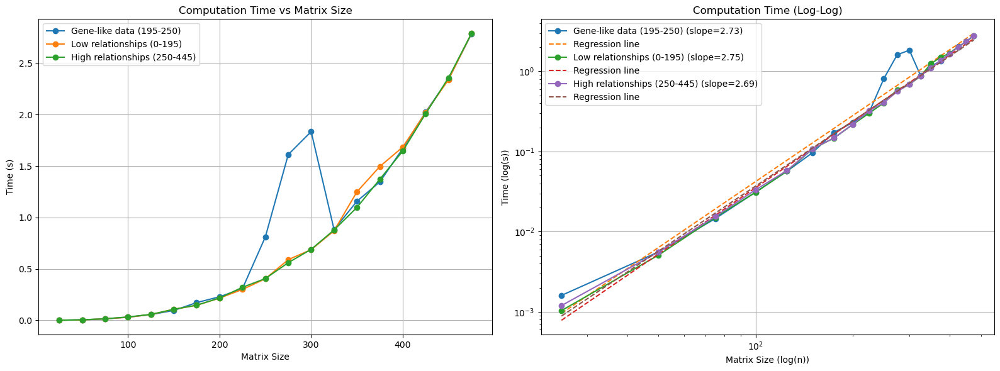

In [33]:
def run_iterative_experiments_with_plotting():
    """
    Run experiments to measure the computation time for constructing trees
    using the max_LCS_tree_iterative algorithm for varying input types and sizes.
    """
    input_types = [
        ("Gene-like data (195-250)", 195, 250),
        ("Low relationships (0-195)", 0, 195),
        ("High relationships (250-445)", 250, 445),
    ]
    sizes = [x for x in range(25, 500, 25)]  # Adjusted size range for manageability

    results = {name: {'sizes': [], 'times': []} for name, _, _ in input_types}

    for input_name, lower, upper in input_types:
        for n in sizes:
            # Generate random LCS matrix
            matrix = generate_matrix(n, lower, upper)

            # Measure the time for tree construction
            start_time = time.time()
            try:
                max_LCS_tree_iterative(matrix)
                elapsed_time = time.time() - start_time

                # Log the results
                results[input_name]['sizes'].append(n)
                results[input_name]['times'].append(elapsed_time)

            except Exception as e:
                print(f"Error with {input_name}, size {n}: {e}")

    plot_iterative_results(results)

def plot_iterative_results(results):
    """
    Plot the computation time for the max_LCS_tree_iterative algorithm across input types.

    Parameters:
        results (dict): Dictionary containing sizes and times for each input type.
    """
    fig, ax = plt.subplots(1, 2, figsize=(16, 6))

    for input_name, data in results.items():
        sizes = np.array(data['sizes'])
        times = np.array(data['times'])

        # Linear plot of computation time
        ax[0].plot(sizes, times, marker='o', label=input_name)

        # Log-log plot of computation time with regression
        log_sizes = np.log(sizes)
        log_times = np.log(times)
        slope, intercept, _, _, _ = linregress(log_sizes, log_times)
        ax[1].loglog(sizes, times, marker='o', label=f"{input_name} (slope={slope:.2f})")
        ax[1].loglog(sizes, np.exp(intercept) * sizes ** slope, linestyle='--', label="Regression line")

    # Linear plot 
    ax[0].set_title("Computation Time vs Matrix Size")
    ax[0].set_xlabel("Matrix Size")
    ax[0].set_ylabel("Time (s)")
    ax[0].legend()
    ax[0].grid(True)

    # Log-log plot 
    ax[1].set_title("Computation Time (Log-Log)")
    ax[1].set_xlabel("Matrix Size (log(n))")
    ax[1].set_ylabel("Time (log(s))")
    ax[1].legend()
    ax[1].grid(True)

    plt.tight_layout()
    plt.show()

run_iterative_experiments_with_plotting()


## Recursive Global Approach

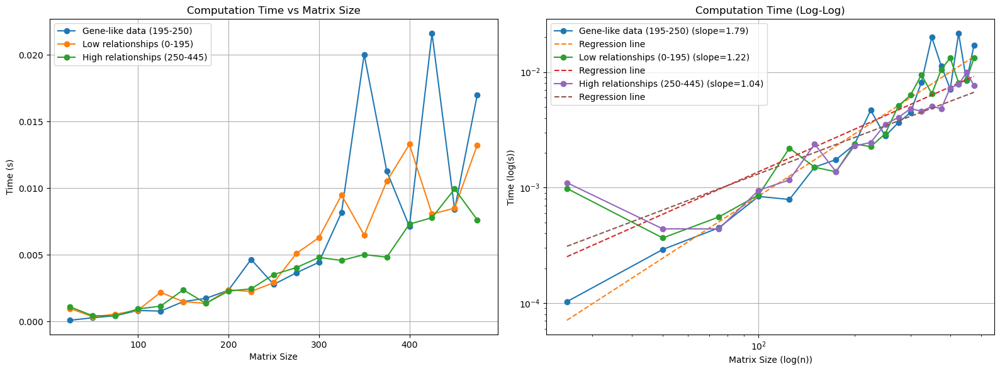

In [34]:
def run_recursive_experiments_with_plotting():
    """
    Run experiments to measure the computation time for constructing trees
    using the max_LCS_tree_recursive algorithm for varying input types and sizes.
    """
    input_types = [
        ("Gene-like data (195-250)", 195, 250),
        ("Low relationships (0-195)", 0, 195),
        ("High relationships (250-445)", 250, 445),
    ]
    sizes = [x for x in range(25, 500, 25)]  # Adjusted size range for manageability

    results = {name: {'sizes': [], 'times': []} for name, _, _ in input_types}

    for input_name, lower, upper in input_types:
        for n in sizes:
            # generate random LCS matrix
            matrix = generate_matrix(n, lower, upper)

            # measure the time 
            start_time = time.time()
            memo = {}
            root = [[-1 for _ in range(n)] for _ in range(n)]
            try:
                max_LCS_tree_recursive(matrix, 0, n - 1, memo, root)
                elapsed_time = time.time() - start_time

                # results
                results[input_name]['sizes'].append(n)
                results[input_name]['times'].append(elapsed_time)

            except Exception as e:
                print(f"Error with {input_name}, size {n}: {e}")

    plot_recursive_results(results)

def plot_recursive_results(results):
    """
    Plot the computation time for the max_LCS_tree_recursive algorithm across input types.

    Parameters:
        results (dict): Dictionary containing sizes and times for each input type.
    """
    fig, ax = plt.subplots(1, 2, figsize=(16, 6))

    for input_name, data in results.items():
        sizes = np.array(data['sizes'])
        times = np.array(data['times'])

        # linear plot
        ax[0].plot(sizes, times, marker='o', label=input_name)

        # log-log plot of 
        log_sizes = np.log(sizes)
        log_times = np.log(times)
        slope, intercept, _, _, _ = linregress(log_sizes, log_times)
        ax[1].loglog(sizes, times, marker='o', label=f"{input_name} (slope={slope:.2f})")
        ax[1].loglog(sizes, np.exp(intercept) * sizes ** slope, linestyle='--', label="Regression line")

    # Linear plot 
    ax[0].set_title("Computation Time vs Matrix Size")
    ax[0].set_xlabel("Matrix Size")
    ax[0].set_ylabel("Time (s)")
    ax[0].legend()
    ax[0].grid(True)

    # Log-log plot 
    ax[1].set_title("Computation Time (Log-Log)")
    ax[1].set_xlabel("Matrix Size (log(n))")
    ax[1].set_ylabel("Time (log(s))")
    ax[1].legend()
    ax[1].grid(True)

    plt.tight_layout()
    plt.show()

run_recursive_experiments_with_plotting()


# Question 6: Probability Estimation


Is LCS a good metric for increasing number of gene sequences? NO, because we will just be computing larger and larger sums which could eventually lead to integer explosion and other bottlenecks. To solve this we change our optimization problem to a minimization, instead of maximization problem. That is when we introduce the levensthein distance. 



## Levensthein Distance


In [35]:
genes = [
    (
        "a",
        "ATGGTGCGAAAGCATCTCTTTTCGTGGCGTGATAAGTTTTATGGTATCCCCGGACGTTGGCTACTACAATTCTCCGAAGTATAAGTGAGTAGGATATGTCAATAACAAGAGGGGATGCGTGACGCATTAGCACCAACTGAATCAAACGATAACTAACGTGGTTTCAGTGAGCGTATGTGGCAAAGGATTGGATACATTTTTCGAGCACGTCTACATAATGACCGTGACAATACTGGAGACTCCGTACCGTCATCTTGACACTCCT",
    ),
    (
        "b",
        "TGGTGCGAAAGCATCTCTTTTCCGTGGCGTATAGTTTTATGGTATCCCCGGAACGCTGGCTACTACAATCTCCGAAGTATAGAGTGAGTAGATTTAATTAACAGAGGGCGTCGTTGACGCATTAGCACCAACTGAATCAACCGATAACTTAACGTGGGTTTCAGTGACTATAGGGCAAAGGATGAACATTTTCGAGCAGCTCTAATAATGAGCGTGACAATATGAATCCACACCGTCATCTTGAACTCCT",
    ),
    (
        "c",
        "TCTGTGCGATATACATCTCTATCGTTGCGGTATGTTTTATGTGCATCACCCCACGCGCTGGCTACAGTACAATCTGCTGGAAGTACTAGGTGGTAGTTAATAACTAGGGTGCGTCGTTGCGCATTACACAACTGGACAACCACTTAACTGGGGTAATCAGTGTTTAGGGCAGACAAGATGAAAACAAGTTTTCGAGCAGGCTCCTATAATGAGGACGGAACGTTAATAAATCCAACACCGCACTGCTTCGTAACCCT",
    ),
    (
        "d",
        "ATGAGGCGCAAAATTCTCTTTCTCGTGGCGCTGATTAAGTTTTATGTATCCCCGGACGTTGGCTACTGACAATTGCTCCGAAGTATAAAGTAGTAGGATATGTCAATAACAAAGACGGGGATAGCGTGACAGCATTAGAACGCAACTGGAATCAAACGTAACCTAAAGGGTTGTCAGGAGCGTATGTGGTCAAAAAGGATTGGATGACATTTTTCGACACGTCTACATAATGACCTGTGACAAACTAGGAGACCTCCTACTCGGTCAATCTTGACGACTCCT",
    ),
    (
        "e",
        "TGGTGCGATATACATCTCTTTTCGTGCGTATGTTTTATGGTGATCACCCGGAACCGCTGGCTACATACAATCTCTGGAAGTACTAGGTGGTAGTTTAATAACTAGAGGTGCGTCGTTGACGCATTACACAACTGGATCAACCGAACTTAACTGGGTATCAGTGATATAGGGCGACAAGATGAACAATTTTCGAGCAGCTCCTGAATAATGAGACGGAACGTATAATCCAACACCGTCACTGCTTCGAACCCT",
    ),
    (
        "f",
        "GGGGGAAAGCGATCCCTTATCGTGGCTGTGATAAGTTTTTATCGGGTATCCGCCGGACGTTGGCGTACTACAATTCTCCGAAGTTAAGTGAGTTAGGGATATAGTCAATAACAAGAGGGGATTGTCGTGACGCATAGCACACAACTGAATCAAATCGATAACTAAACGGGTTTCAGTAGAGCGTTGTGGCAAAGATTGGATACATTTTTCGCAGGACGTCTTACCTAATGACGTGGACAATAACTGGCAGACGTCCGTACCGTCATCTTGACCACTCCCT",
    ),
    (
        "g",
        "TGGTGCGATATACATCCTCTTTTCGTGCGTATGTTTTAGGTACACCGGATACGCCTGGCTTACAAGTACCAATCTCTGAGAAGTCACTGAGGTGGTAGTTTAATAACTAGAAGGGTGCGTCGGACGCATTCACACATACTGGATCAACCGAGACTTAACTGGGGTATCAGTGATTGATAGGGCGACAAGATATACAATTTTCGAGCAGCTCCCTGAATAAGTGAAGAACGGAGACGTATAATCCAACACGATTCACTGCTTCGAACCCT",
    ),
]

In [36]:
def levenshtein_distance_with_operations(A, B):
    """
    Compute the Levenshtein distance between two strings and track the number of
    operations (insertions, deletions, substitutions, and matches).

    Parameters:
        A (str): The first string.
        B (str): The second string.

    Returns:
        tuple: A tuple containing:
            - total_operations (int): Total number of operations.
            - matches (int): Number of character matches.
            - insertions (int): Number of insert operations.
            - deletions (int): Number of delete operations.
            - substitutions (int): Number of substitution operations.
    """
    n = len(A)  # Length of the first string
    m = len(B)  # Length of the second string

    # Initialize a 2D matrix to store Levenshtein distances
    D = [[0] * (m + 1) for _ in range(n + 1)]

    # Fill the base cases: transforming an empty string to another string
    for i in range(1, n + 1):
        D[i][0] = i  # Cost of deleting characters
    for j in range(1, m + 1):
        D[0][j] = j  # Cost of inserting characters

    # Populate the distance matrix
    for i in range(1, n + 1):
        for j in range(1, m + 1):
            if A[i - 1] == B[j - 1]:  # Characters match, no cost
                cost = 0
            else:  # Characters do not match, substitution cost is 1
                cost = 1

            # Minimum cost of deletion, insertion, or substitution
            D[i][j] = min(
                D[i - 1][j] + 1,       # Deletion
                D[i][j - 1] + 1,       # Insertion
                D[i - 1][j - 1] + cost # Substitution
            )

    # Backtrack through the matrix to determine the operations performed
    i, j = n, m
    insertions = deletions = substitutions = matches = 0

    while i > 0 and j > 0:
        if A[i - 1] == B[j - 1]:  # Characters match
            matches += 1
            i -= 1
            j -= 1
        elif D[i][j] == D[i - 1][j] + 1:  # Deletion
            deletions += 1
            i -= 1
        elif D[i][j] == D[i][j - 1] + 1:  # Insertion
            insertions += 1
            j -= 1
        else:  # Substitution
            substitutions += 1
            i -= 1
            j -= 1

    # Handle remaining characters in A or B
    while i > 0:
        deletions += 1
        i -= 1
    while j > 0:
        insertions += 1
        j -= 1

    # Calculate the total number of operations
    total_operations = insertions + deletions + substitutions + matches
    return total_operations, matches, insertions, deletions, substitutions


In [37]:
def normalize_transition_matrix(matrix):
    column_sums = matrix.sum(axis=0)  # Sum across columns
    normalized_matrix = matrix / column_sums[np.newaxis, :]  # Divide each column by its sum
    return normalized_matrix

def build_transition_matrix(X, Y):
    n = len(X)
    m = len(Y)
    
    total_operations, matches, insertions, deletions, substitutions = (
        levenshtein_distance_with_operations(X, Y)
    )
    
    # Total operations include matches
    total_operations = matches + insertions + deletions + substitutions
    
    # Probabilities
    p_match = matches / total_operations
    p_substitute = substitutions / total_operations
    p_insert = insertions / total_operations
    p_delete = deletions / total_operations
    
    # Transition matrix
    transition_matrix = np.array([
        [p_match, p_substitute, p_insert],  # Row A
        [p_substitute, p_match, p_insert],  # Row B
        [p_delete, p_delete, 1 - 2 * p_delete]  # Row ε
    ])
    
    # Normalize rows to ensure they sum to 1
    #normalized_matrix = normalize_transition_matrix(transition_matrix)
    return transition_matrix

# Example usage
example_matrix = normalize_transition_matrix(build_transition_matrix(genes[0][1], genes[1][1]))
example_rounded_matrix = np.round(example_matrix, 3)
print(f'Transition Matrix from a to b:\n {example_rounded_matrix}')


Transition Matrix from a to b:
 [[0.887 0.019 0.041]
 [0.019 0.887 0.041]
 [0.094 0.094 0.918]]


In [38]:
# Assuming 'genes' is a list of tuples, where each tuple contains a gene name and its sequence
transition_matrices = []

# Compute pairwise transition matrices for all pairs of genes
for i in range(len(genes)):
    for j in range(i + 1, len(genes)):  # Compute only upper triangular matrix
        # Extract sequences from genes[i] and genes[j]
        markov = normalize_transition_matrix(build_transition_matrix(genes[i][1], genes[j][1]))
        transition_matrices.append(markov)

# Compute the average transition matrix from all pairwise matrices
average_matrix = np.mean(transition_matrices, axis=0)

# Round the average matrix to 3 decimals
average_matrix_rounded = np.round(average_matrix, 3)

# Print the final averaged matrix
print("Average Transition Matrix (Rounded to 3 decimals):")
print(average_matrix_rounded)

Average Transition Matrix (Rounded to 3 decimals):
[[0.839 0.065 0.101]
 [0.065 0.839 0.101]
 [0.096 0.096 0.797]]
